In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scanpy as sc
from scipy import stats
import os

from scipy import spatial
from scipy import sparse
from scipy.interpolate import CubicSpline
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
import networkx as nx
from umap import UMAP

import json

In [2]:
import importlib

from scroutines import powerplots
from scroutines.miscu import is_in_polygon

import utils_merfish
importlib.reload(utils_merfish)
from utils_merfish import rot2d, st_scatter, st_scatter_ax, plot_cluster, binning
from utils_merfish import RefLineSegs

from merfish_datasets import merfish_datasets
directories = merfish_datasets
directories

{'P14NRa_ant': 'merfish_06142023/ant/region0',
 'P28NRa_ant': 'merfish_06142023/ant/region1',
 'P14NRa_pos': 'merfish_06142023/pos/region0',
 'P28NRa_pos': 'merfish_06142023/pos/region1',
 'P21NRa_ant': 'merfish_20231114/region0',
 'P21DRa_ant': 'merfish_20231114/region2',
 'P28DRa_ant': 'merfish_20231114/region1',
 'P21NRa_pos': 'merfish_20231120/region0',
 'P21DRa_pos': 'merfish_20231120/region1',
 'P28DRa_pos': 'merfish_20231120/region2',
 'P14NRb_ant': 'merfish_202404051211/region_0',
 'P28NRb_ant': 'merfish_202404051211/region_1',
 'P14NRb_pos': 'merfish_202404051214/region_0',
 'P28NRb_pos': 'merfish_202404051214/region_1',
 'P21NRb_ant': 'merfish_202404091526/region_2',
 'P21DRb_ant': 'merfish_202404091526/region_1',
 'P28DRb_ant': 'merfish_202404091526/region_0',
 'P21NRb_pos': 'merfish_202404091601/region_0',
 'P21DRb_pos': 'merfish_202404091601/region_2',
 'P28DRb_pos': 'merfish_202404091601/region_1',
 'P14NR_ant': 'merfish_06142023/ant/region0',
 'P28NR_ant': 'merfish_06142

In [3]:
def get_qc_metrics(df):
    """
    return metrics
     - key
      - (name, val, medval, bins)
    """
    metrics = {}
    cols  = ['volume', 'gncov', 'gnnum']
    names = ['cell volume', 'num transcripts', 'num genes']
    
    for col, name in zip(cols, names):
        val = df[col].values
        medval = np.median(val)
        bins = np.linspace(0, 10*medval, 50)
        
        metrics[col] = (name, val, medval, bins)
    return metrics

def get_norm_counts(adata, scaling=500):
    """norm - equalize the volume to be 500 for all cells
    """
    cnts = adata.X
    vol = adata.obs['volume'].values
    normcnts = cnts/vol.reshape(-1,1)*scaling
    adata.layers['norm'] = normcnts
    
    return normcnts

In [4]:
def get_largest_spatial_components(adata, k=100, dist_th=80):
    """
    k - number of neighbors
    dist_th - distance to call connected components
    
    returns
        - indices of the largest components
    """
    XY = adata.obs[['x', 'y']].values
    nc = len(XY)

    # kNN
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='auto').fit(XY)
    distances, indices = nbrs.kneighbors(XY)

    # filtered by distance th
    val = distances[:,1:].reshape(-1,)
    i = np.repeat(indices[:,0],k-1)
    j = indices[:,1:].reshape(-1,)

    indices_filtered = np.vstack([i[val < dist_th], j[val < dist_th]]).T

    G = nx.Graph()
    G.add_nodes_from(np.arange(nc))
    G.add_edges_from(indices_filtered)
    components = nx.connected_components(G)
    largest_component = max(components, key=len)
    indices_selected = np.array(list(largest_component))

    print(f"fraction of cells included: {len(largest_component)/nc: .2f}" )
    
    return indices_selected, XY

# load data and construct adata 

In [5]:
np.random.seed(0)

In [6]:
outdir     = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/plots_240718"
outdatadir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/merfish/organized"
!mkdir -p $outdir
!mkdir -p $outdatadir

In [7]:
name = 'P28NRa_pos'
dirc = directories[name]

f1 = os.path.join('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/merfish', dirc, 'cell_by_gene.csv')
f2 = os.path.join('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/merfish', dirc, 'cell_metadata.csv')
output      = outdatadir + f'/{name}_ctxglut_240712.h5ad'

# meta_operations = {
#     'rotation': None,
#     'ref_line': None,
#     'bound_lrd': None, #  (0,0,0),   # (left, right, depth)
# }

In [8]:
df1 = pd.read_csv(f1)
df2 = pd.read_csv(f2)
genes = df1.iloc[:,1:-50].columns
blnks = df1.iloc[:, -50:].columns
print(df1.shape, df2.shape, len(genes), len(blnks))

df = df2.join(df1)
assert np.all(df['cell'] == df['EntityID'])


df['fpcov'] =  df[blnks].sum(axis=1)
df['gncov'] =  df[genes].sum(axis=1)
df['gnnum'] = (df[genes]>0).sum(axis=1)

# metrics
metrics = get_qc_metrics(df)  # median, bin, distribution

# adata
metacols = np.hstack([df2.columns, 'gncov', 'gnnum', 'fpcov', ])
adata = ad.AnnData(X=df[genes].values, 
                   obsm=dict(blanks=df[blnks].values),
                   obs=df[metacols], 
                   var=pd.DataFrame(index=genes), 
                  )

(378910, 551) (378910, 17) 500 50


/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


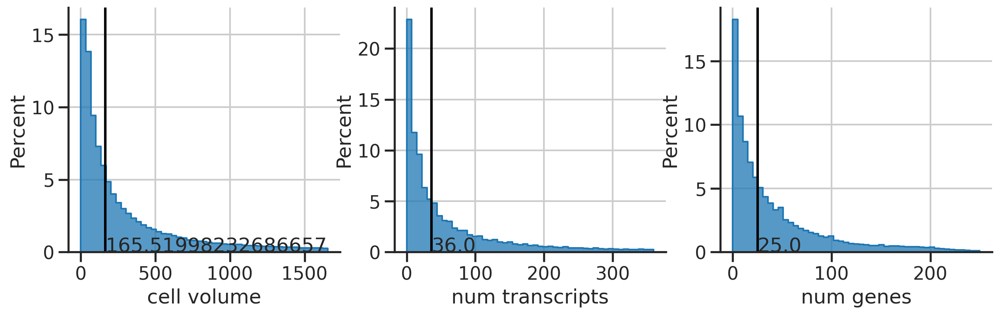

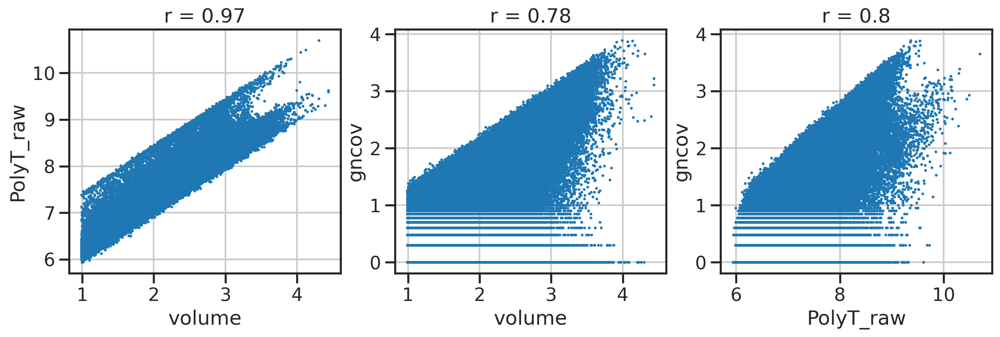

In [9]:
fig, axs = plt.subplots(1,3,figsize=(3*5,1*4))
for ax, (key, metric) in zip(axs, metrics.items()):
    (name, val, medval, bins) = metric
    
    sns.histplot(val, element='step', bins=bins, ax=ax, stat='percent')
    sns.despine(ax=ax)
    ax.axvline(medval, color='k',)
    ax.text(medval, 0, medval)
    ax.set_xlabel(name)
plt.show()


factors = np.array(['volume', 'PolyT_raw', 'gncov'])
pairs = [[0,1], [0,2], [1,2]]
fig, axs = plt.subplots(1,3,figsize=(3*5,1*4))
for pair, ax in zip(pairs, axs):
    f0 = factors[pair[0]]
    f1 = factors[pair[1]]
    x, y = np.log10(1+df[f0]), np.log10(1+df[f1])
    r, p = stats.pearsonr(x, y)
    ax.scatter(x, y, s=1)
    ax.set_xlabel(f0)
    ax.set_ylabel(f1)
    ax.set_title(f'r = {r:.2g}')
    
plt.show()

# rotation

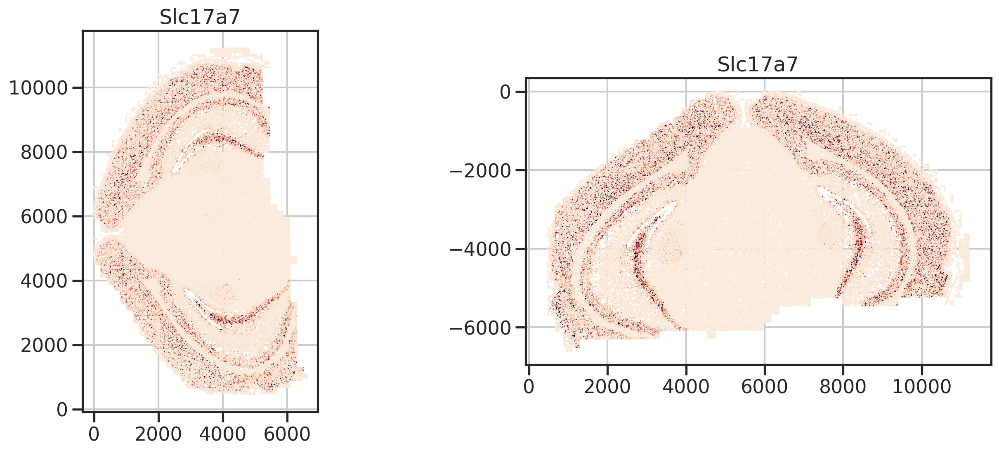

In [10]:
# calibrate coordinates
rotation = -90
adata.uns['rotation'] = rotation

x = adata.obs['center_x']
y = adata.obs['center_y']
xr, yr = rot2d(x, y, rotation)
adata.obs['x'] = xr
adata.obs['y'] = yr

gn = 'Slc17a7'
g = adata[:,gn].X.reshape(-1,)
fig, axs = plt.subplots(1,2,figsize=(2*8,1*6))
ax1, ax2 = axs
st_scatter_ax(fig, ax1, x,  y,  gexp=g, title=gn, axis_off=False)
st_scatter_ax(fig, ax2, xr, yr, gexp=g, title=gn, axis_off=False)
plt.show()

# filter #1 basic QC metrics

In [11]:
print(adata.shape)
# basic QC filter
cond = np.all([
    adata.obs['volume'] > 50, 
    adata.obs['volume'] < 2000, 
    adata.obs['fpcov'] < 5,
    adata.obs['gncov'] > 10,
    adata.obs['x'] > 5500,
    adata.obs['y'] > -5100,
], axis=0)

adata = adata[cond]
print(adata.shape)

(378910, 500)
(109784, 500)


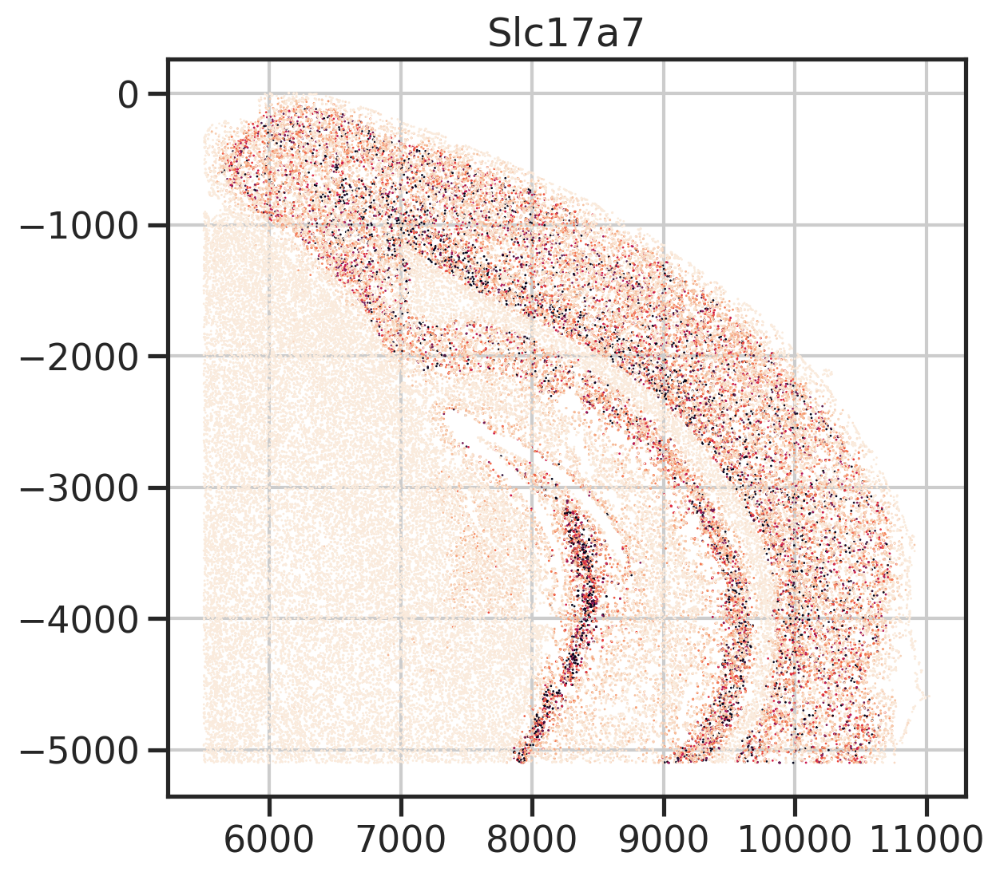

In [12]:
gns = [
    'Slc17a7',
    ]
for gn in gns: 
    g = adata[:,gn].X.reshape(-1,)
    xr = adata.obs['x']
    yr = adata.obs['y']
    fig, ax = plt.subplots(1,1,figsize=(1*8,1*6))
    st_scatter_ax(fig, ax, xr, yr, gexp=g, title=gn, axis_off=False)
    plt.show()

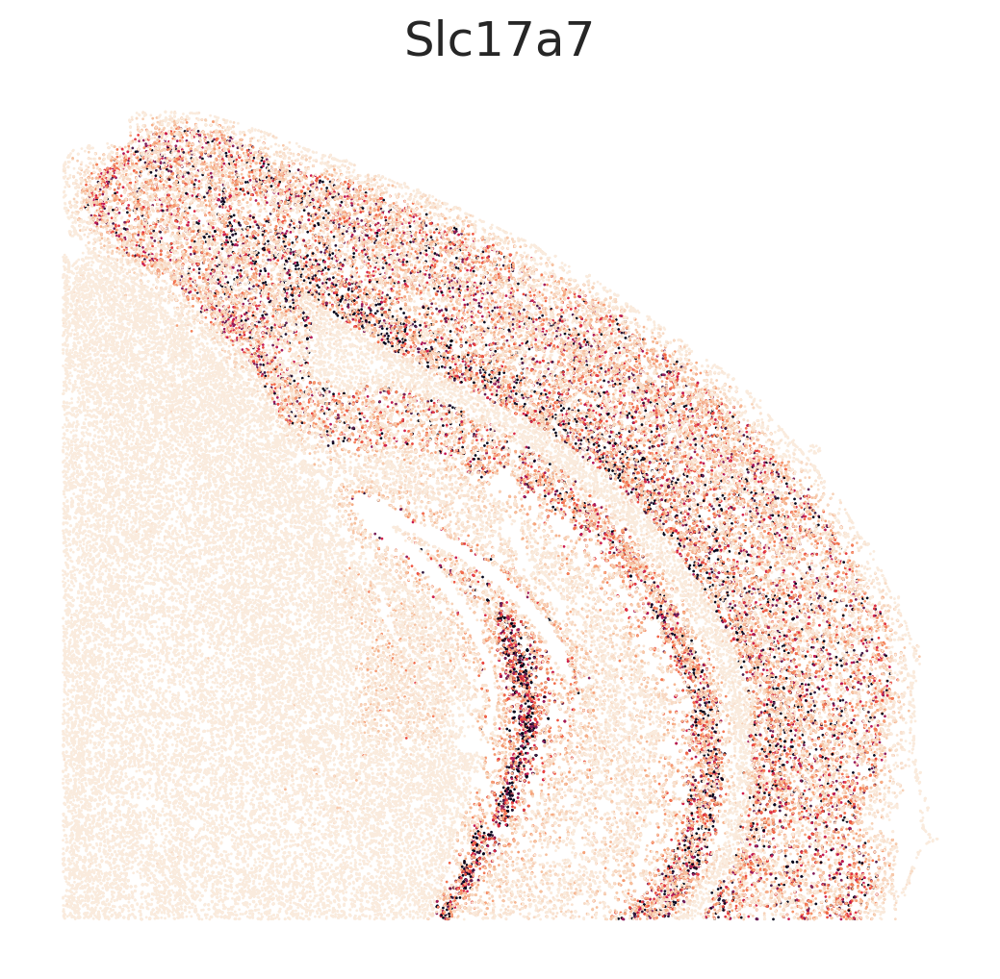

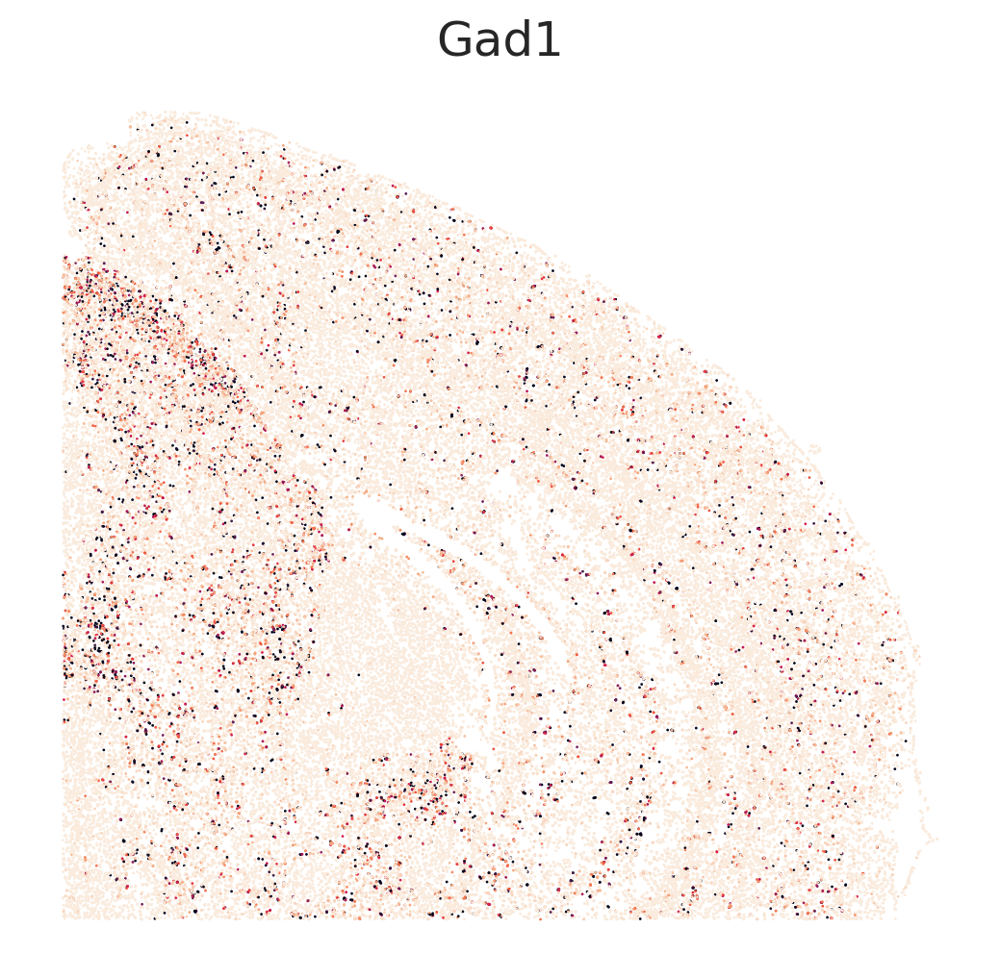

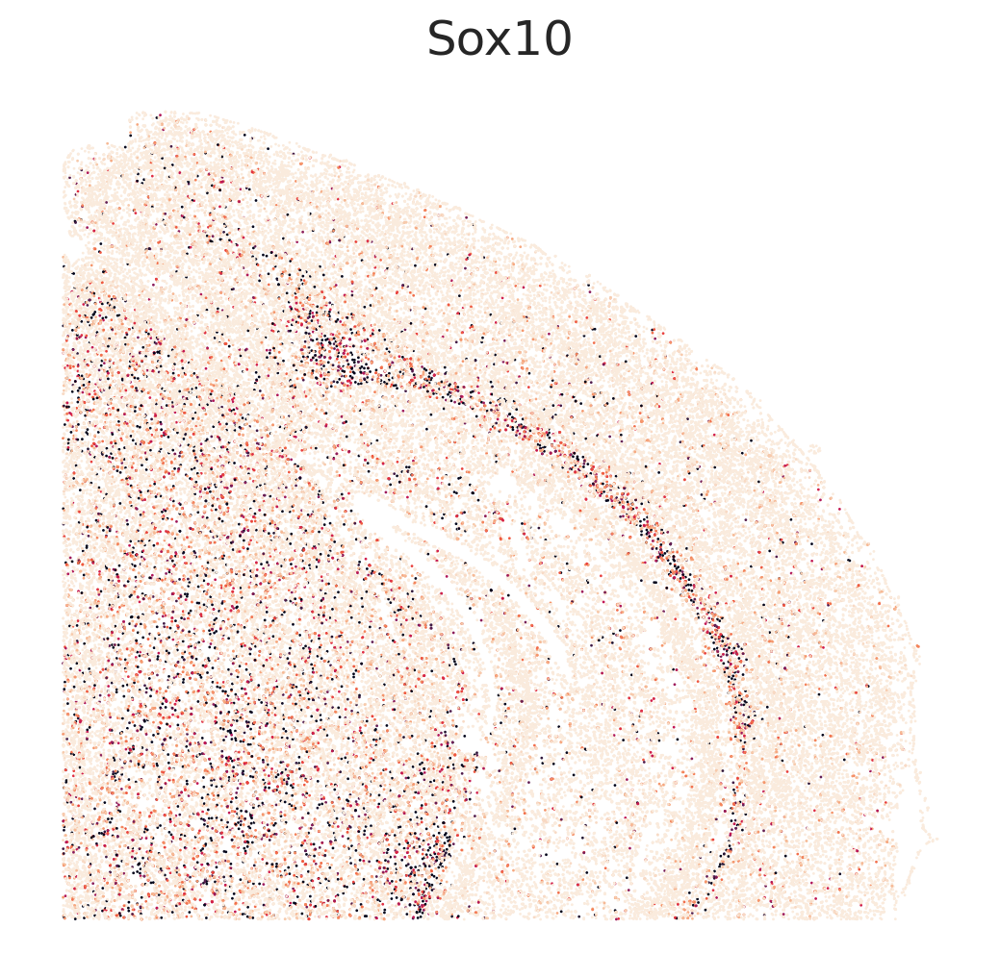

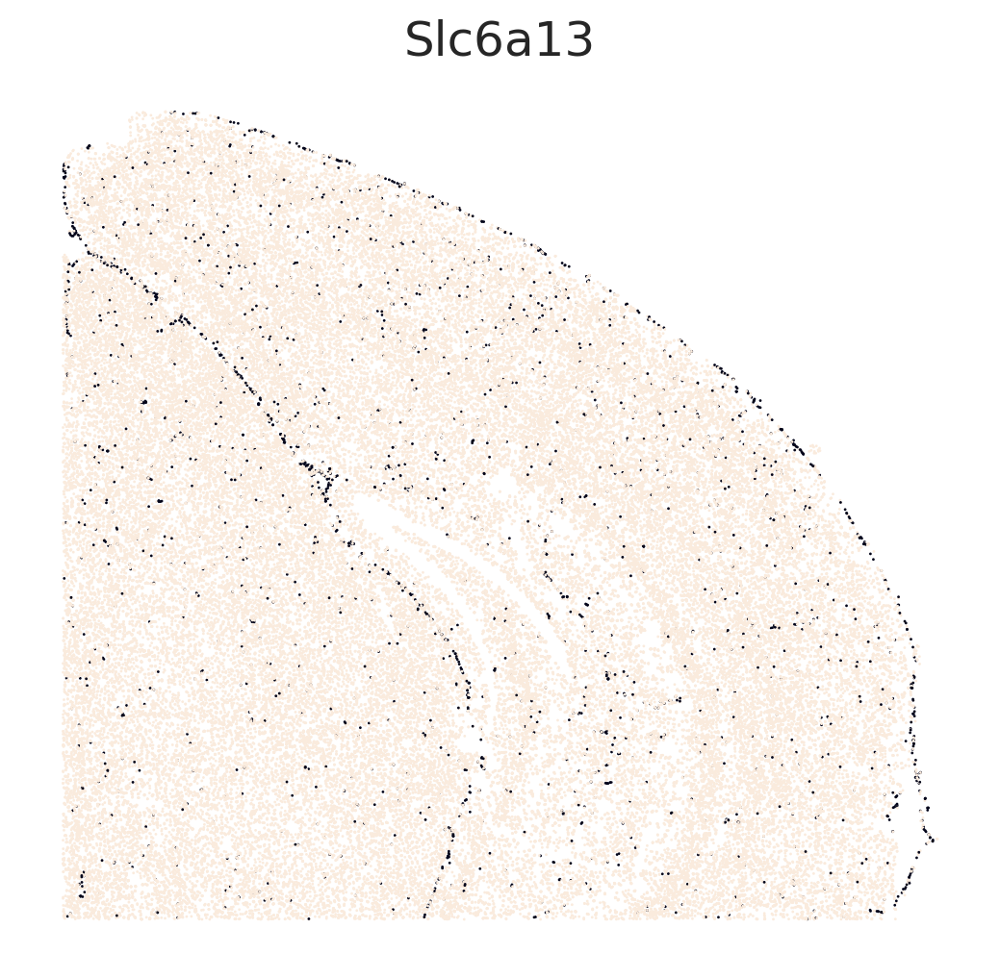

In [13]:
gns = [
    'Slc17a7',
    'Gad1',
    'Sox10', 
    'Slc6a13',
    ]
for gn in gns: 
    g = adata[:,gn].X.reshape(-1,)
    xr = adata.obs['x']
    yr = adata.obs['y']
    fig, ax = plt.subplots(1,1,figsize=(1*8,1*6))
    st_scatter_ax(fig, ax, xr, yr, gexp=g, title=gn, axis_off=False)
    ax.axis(False)
    plt.show()

# spatial domain analysis

In [14]:
importlib.reload(utils_merfish)

<module 'utils_merfish' from '/u/project/zipursky/f7xiesnm/v1-bb/v1/myvisctx/analysis_merfish/utils_merfish.py'>

In [15]:
# redo metrics
metrics = get_qc_metrics(adata.obs)
# norm
nrmcnts = get_norm_counts(adata)

# scale log zscore PCs
_, cov, medcov, _ = metrics['gncov']
jnorm = adata.layers['norm']/cov.reshape(-1,1)*250
ljnorm = np.log10(1+jnorm)
zljnorm = stats.zscore(ljnorm, axis=0)
pcs = PCA(n_components=50).fit_transform(zljnorm) # all genes rather than highly variable genes 

# pca
adata.layers['jnorm'] = jnorm
adata.obsm['X_pca'] = pcs

In [16]:
# this part takes long - minutes
# spatial
adata.obsm['X_xy'] = adata.obs[['x', 'y']].values

# gene neighbors and spatial neighbors
sc.pp.neighbors(adata, use_rep='X_pca', random_state=0)
sc.pp.neighbors(adata, use_rep='X_xy', key_added='xy', random_state=0)

# blending
alpha = 0.5
joint_graph = (1 - alpha) * adata.obsp["connectivities"] + alpha * adata.obsp["xy_connectivities"]
sc.tl.leiden(adata, adjacency=joint_graph, key_added="blended_domains", random_state=0)

# tweaking viz 

In [17]:
def generate_discrete_cmap(n_colors_groups, keys=['tab20']):
    """
    """
    import matplotlib.colors as mcolors
    
    palette_list = []
    for n_colors, key in zip(n_colors_groups, keys):
        palette = sns.color_palette(key, n_colors)
        palette_list.append(palette)
    
    palette_list = np.vstack(palette_list)
    cmap = mcolors.ListedColormap(palette_list)
    
    return palette_list, cmap

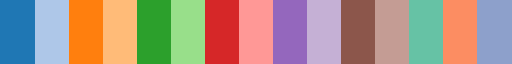

In [18]:
xr =  adata.obs['x']
yr =  adata.obs['y']
clsts = adata.obs['blended_domains'].astype(int) # requires [0,1,2...,N]
n_unq_clsts = len(np.unique(clsts))

clsts_palette, clsts_cmap = generate_discrete_cmap([12, len(np.unique(clsts))-12], keys=['tab20', 'Set2'])
clsts_cmap

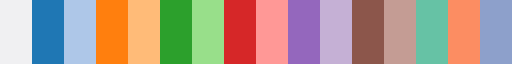

In [19]:
clsts_palette2, clsts_cmap2 = generate_discrete_cmap([1, 12, len(np.unique(clsts))-12], keys=['light:b', 'tab20', 'Set2'])
clsts_cmap2

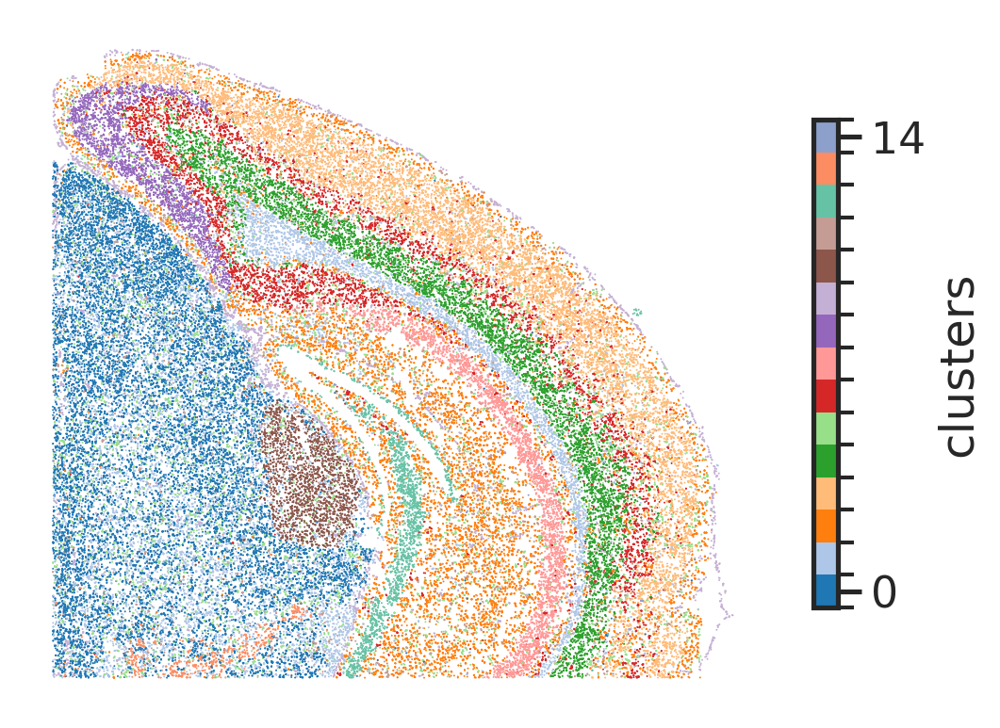

In [20]:
with sns.axes_style('white'): 
    fig, ax = plt.subplots()
    utils_merfish.plot_cluster_simple_ax(fig, ax, clsts, xr, yr, s=0.5, cmap=clsts_cmap) # cmap=plt.cm.tab20)
    plt.show()

# understand the domains - one by one

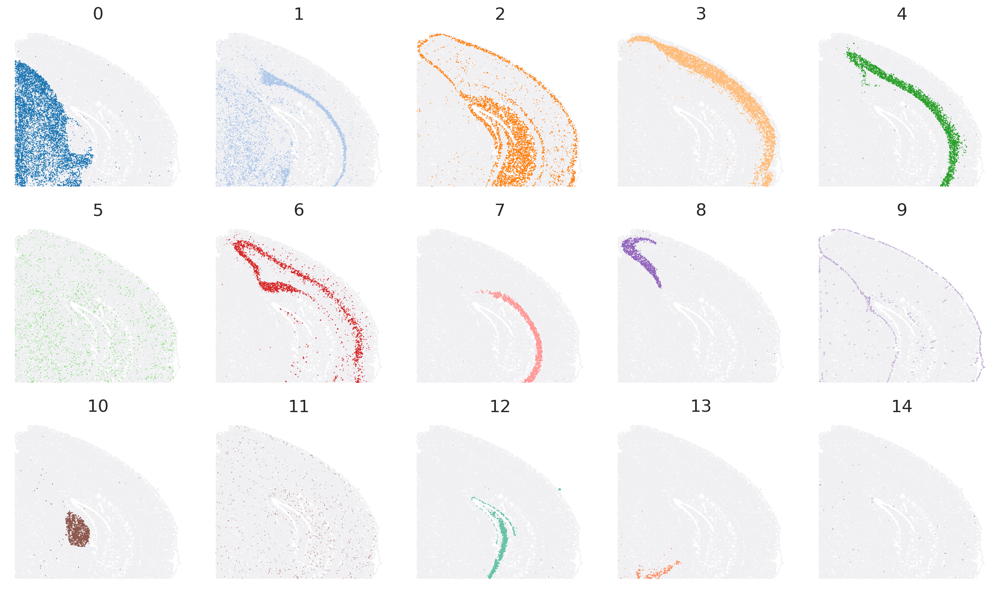

In [21]:
n = n_unq_clsts
nx = 5
ny = int((n+nx-1)/nx)
fig, axs = plt.subplots(ny,nx, figsize=(nx*3,ny*3))
for i in range(n):
    ax = axs.flat[i]
    clsts_this = clsts.copy()
    clsts_this[~(clsts_this==i)] = -1
    clsts_this += 1
    
    utils_merfish.plot_cluster_simple_ax(fig, ax, clsts_this, xr, yr, s=1, cmap=clsts_cmap2, cbar=False) # cmap=plt.cm.tab20)
    ax.set_title(i)
fig.tight_layout()
plt.show()

# get reference line based on cluster 9
- iterative

In [22]:
def line_fitting(XY):
    """
    """
    XY = XY[np.argsort(XY[:,0])]
    x, y = XY[:,0], XY[:,1]

    # fit a line
    poly_fit = np.poly1d(np.polyfit(x, y, 4))
    x_fit = np.linspace(min(x), max(x), 100)
    y_fit = poly_fit(x_fit)

    # calc depth
    XY_fit = np.vstack([x_fit, y_fit]).T
    XY_obj = RefLineSegs(XY_fit)
    depth = XY_obj.ndist_to_qps(XY)
    width = XY_obj.tdist_to_qps(XY)
    DW = np.vstack([depth, width]).T

    return XY, XY_fit, XY_obj, DW, poly_fit 

In [23]:
cond1 = adata.obs['blended_domains'].astype(int)==9
cond2 = adata.obs['x']+adata.obs['y'] > 6000
# adata_pia = adata[cond1] # requires [0,1,2...,N]
adata_pia = adata[cond1 & cond2] # requires [0,1,2...,N]
adata_pia

View of AnnData object with n_obs × n_vars = 926 × 500
    obs: 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'blended_domains'
    uns: 'rotation', 'neighbors', 'xy', 'leiden'
    obsm: 'blanks', 'X_pca', 'X_xy'
    layers: 'norm', 'jnorm'
    obsp: 'distances', 'connectivities', 'xy_distances', 'xy_connectivities'

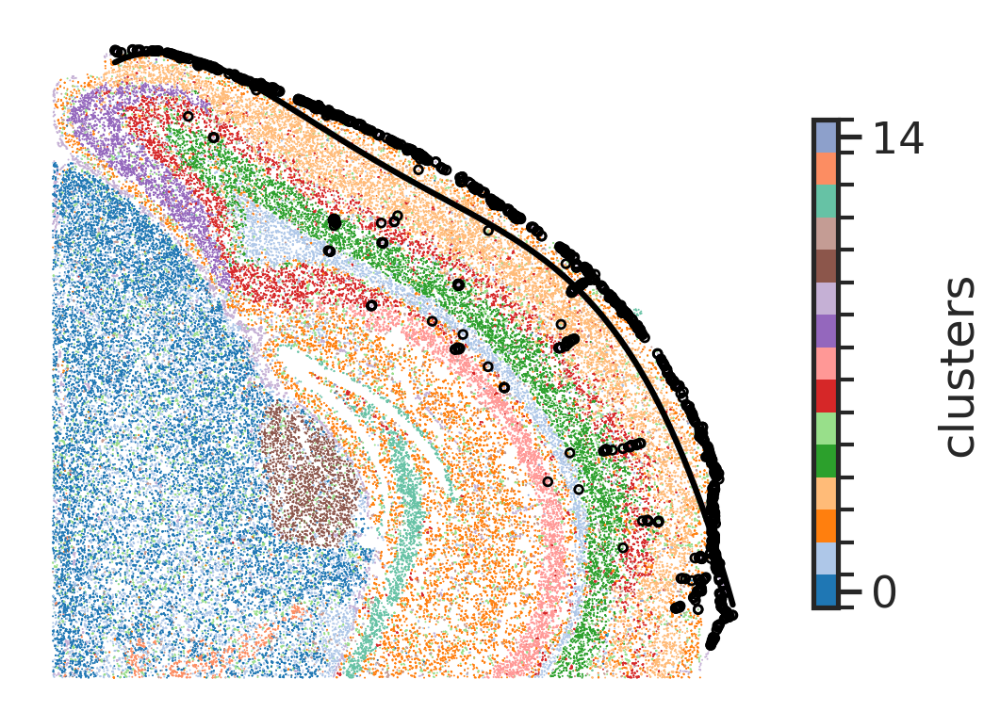

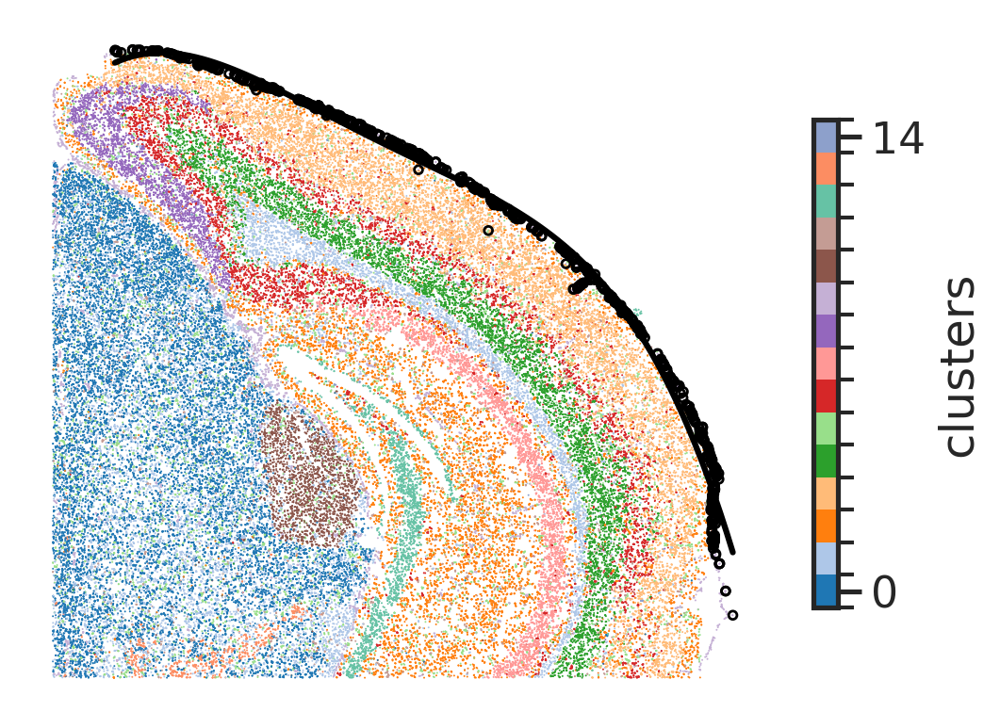

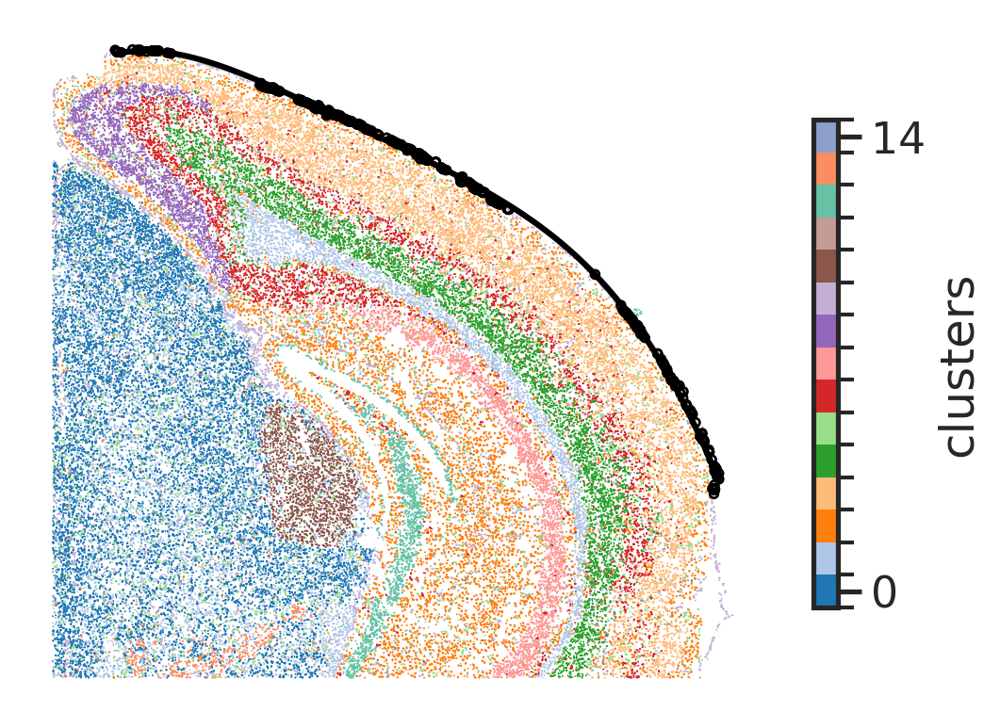

In [24]:
XY = adata_pia.obs[['x', 'y']].values
for i in range(3):
    XY, XY_fit, XY_obj, DW, poly_fit = line_fitting(XY)
    depth, width = DW[:,0], DW[:,1]
    cond = depth < 0.05*np.percentile(depth, 95)

    with sns.axes_style('white'): 
        fig, ax = plt.subplots()
        xr =  adata.obs['x']
        yr =  adata.obs['y']
        clsts = adata.obs['blended_domains'].astype(int) # requires [0,1,2...,N]
        utils_merfish.plot_cluster_simple_ax(fig, ax, clsts, xr, yr, s=0.5, cmap=clsts_cmap, alpha=1) # cmap=plt.cm.tab20)
        
        x, y = XY[:,0], XY[:,1]
        x_fit, y_fit = XY_fit[:,0], XY_fit[:,1]
        ax.scatter(x, y, s=10, edgecolors='k', facecolors='none', linewidth=1)
        ax.plot(x_fit, y_fit, color='k')
        plt.show()

    XY = XY[cond]

In [25]:
# save
XY = adata.obs[['x', 'y']].values

adata.uns['ref_line'] = XY_fit.tolist()
adata.obs['depth'] = XY_obj.ndist_to_qps(XY)
adata.obs['width'] = XY_obj.tdist_to_qps(XY)

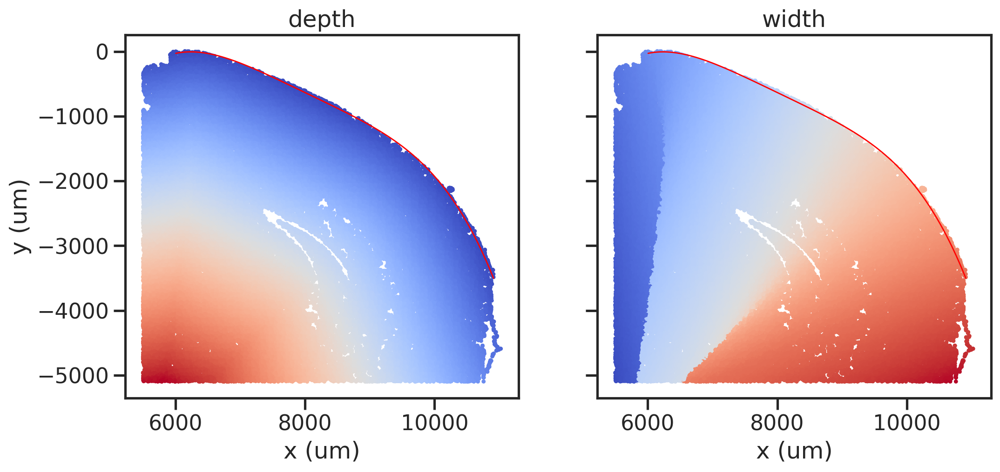

In [26]:
fig, axs = plt.subplots(1,2,figsize=(12,8*2), sharex=True, sharey=True)
for ax, lbl in zip(axs, ['depth', 'width']):
    
    ax.plot(XY_fit[:,0], 
            XY_fit[:,1], '-r', linewidth=1)
    

    sns.scatterplot(data=adata.obs, x='x', y='y', 
                    hue=lbl, 
                    palette='coolwarm',
                    legend=False,
                    s=10, edgecolor='none', ax=ax)
    ax.grid(False)
    ax.set_aspect('equal')
    ax.set_xlabel('x (um)')
    ax.set_ylabel('y (um)')
    ax.set_title(f'{lbl}')


In [27]:
XY_fit = np.array(adata.uns['ref_line'])
ref_width = XY_obj.tdist_to_qps(XY_fit)
ref_width_x = np.interp(np.arange(0,np.max(ref_width),500), ref_width, XY_fit[:,0])
ref_width_y = poly_fit(ref_width_x)

dx = 0.01
dy = poly_fit(ref_width_x+dx) - ref_width_y
s = np.sqrt(dx**2+dy**2)
dx, dy = 1/s*dx, 1/s*dy

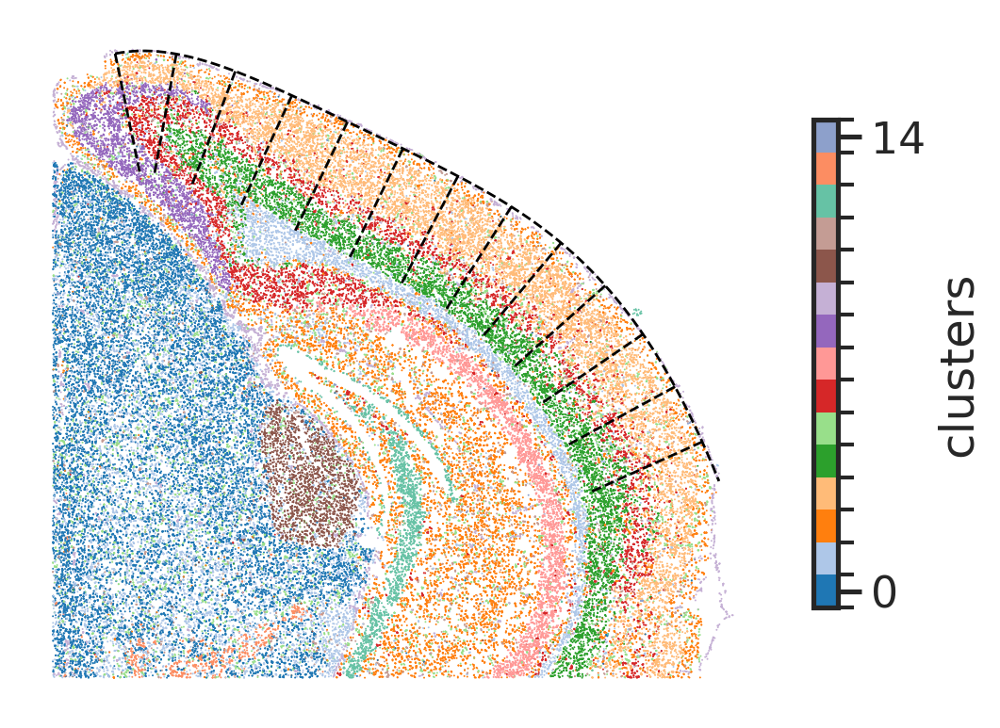

In [28]:


with sns.axes_style('white'): 
    fig, ax = plt.subplots()
    xr =  adata.obs['x']
    yr =  adata.obs['y']
    clsts = adata.obs['blended_domains'].astype(int) # requires [0,1,2...,N]
    utils_merfish.plot_cluster_simple_ax(fig, ax, clsts, xr, yr, s=0.5, cmap=clsts_cmap, alpha=1) # cmap=plt.cm.tab20)

    x_fit, y_fit = XY_fit[:,0], XY_fit[:,1]
    ax.plot(x_fit, y_fit, color='k', linestyle='--', linewidth=1)
    # ax.scatter(ref_width_x, ref_width_y) #y, c=ref_width, cmap='rainbow', s=1) # color='k', linestyle='--')
    for i in range(len(ref_width_x)):
        scale = 1000
        _x, _y = ref_width_x[i], ref_width_y[i]
        _dx, _dy = dx[i], dy[i]
        _dx, _dy = scale*_dx, scale*_dy
                    

        ax.plot([_x, _x+_dy], 
                [_y, _y-_dx], color='k', linestyle='--', linewidth=1) #y, c=ref_width, cmap='rainbow', s=1) # color='k', linestyle='--')
    
    plt.show()

# filter #3. select cortex

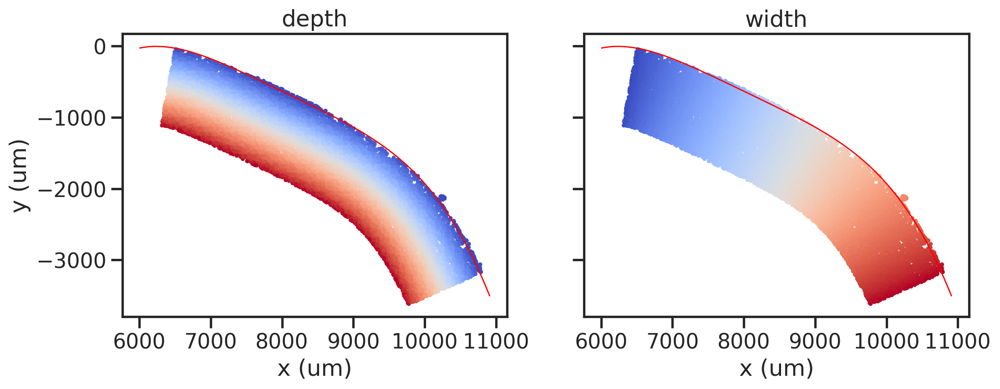

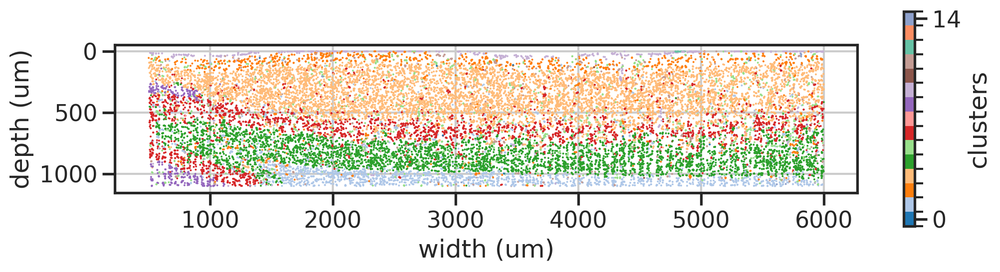

In [29]:
cond = np.all([
    adata.obs['depth'] < 1100,
    adata.obs['width'] > 500,
    adata.obs['width'] < 6000,
    ], axis=0)


adatasub = adata[cond].copy()

fig, axs = plt.subplots(1,2,figsize=(12,8*2), sharex=True, sharey=True)
for ax, lbl in zip(axs, ['depth', 'width']):
    
    ax.plot(XY_fit[:,0], 
            XY_fit[:,1], '-r', linewidth=1)
    
    sns.scatterplot(data=adatasub.obs, x='x', y='y', 
                    hue=lbl, 
                    palette='coolwarm',
                    legend=False,
                    s=10, edgecolor='none', ax=ax)
    ax.grid(False)
    ax.set_aspect('equal')
    ax.set_xlabel('x (um)')
    ax.set_ylabel('y (um)')
    ax.set_title(f'{lbl}')
plt.show()
    
fig, ax = plt.subplots(1,1,figsize=(12,4*1))
d     = adatasub.obs['depth']
w     = adatasub.obs['width']
clsts = adatasub.obs['blended_domains'].astype(int) # requires [0,1,2...,N]
utils_merfish.plot_cluster_simple_ax(fig, ax, clsts, w, d, s=2, cmap=clsts_cmap, axis_off=False) # cmap=plt.cm.tab20)

# clsts_this = clsts.copy()
# clsts_this[~clsts_this.isin(clsts_sel)] = -1
# clsts_this += 1
# utils_merfish.plot_cluster_simple_ax(fig, ax, clsts_this, w, d, s=2, cmap=clsts_cmap2, axis_off=False) # cmap=plt.cm.tab20)
ax.set_aspect('equal')
ax.set_xlabel('width (um)')
ax.set_ylabel('depth (um)')
ax.invert_yaxis()
plt.show()

# Plot area and layer signatures

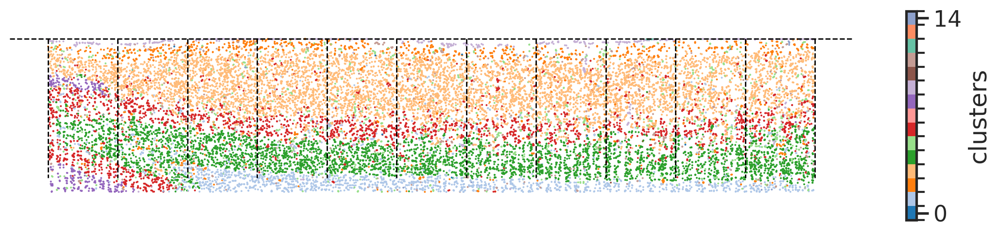

In [30]:
d     = -adatasub.obs['depth']
w     =  adatasub.obs['width']
clsts =  adatasub.obs['blended_domains'].astype(int) # requires [0,1,2...,N]

fig, ax = plt.subplots(1,1,figsize=(14,4*1))
utils_merfish.plot_cluster_simple_ax(fig, ax, clsts, w, d, s=2, cmap=clsts_cmap, axis_off=False) # cmap=plt.cm.tab20)

ax.vlines(np.arange(500,6000+1,500), 0, -1000, color='k', linestyle='--', linewidth=1) # , zorder=0)
ax.axhline(0, color='k', linestyle='--', linewidth=1) #, zorder=0)

ax.set_aspect('equal')
# ax.invert_yaxis()
ax.axis('off')
# ax.grid(False)
# ax.set_xlabel('width (um)')
# ax.set_ylabel('depth (um)')
plt.show()

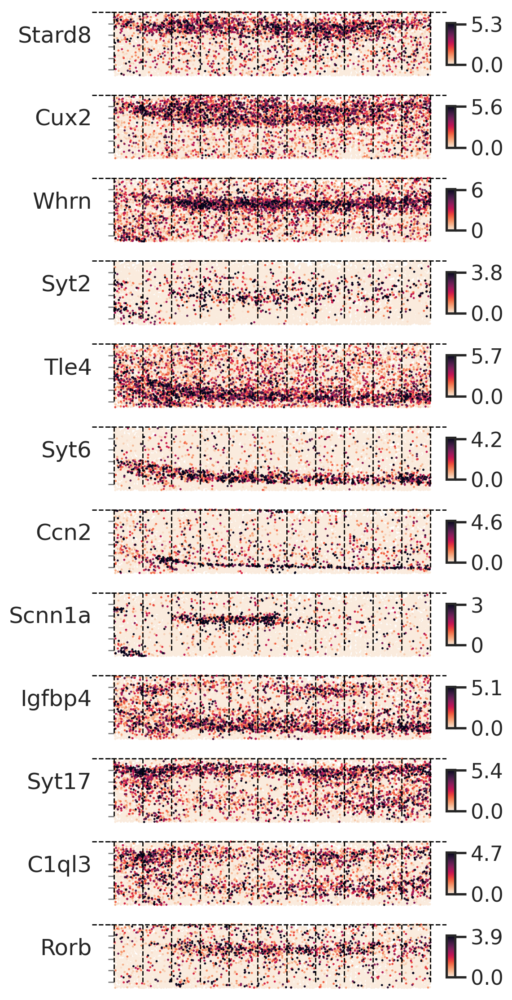

In [31]:
gns = [ 
    'Stard8', 'Cux2', 'Whrn', 'Syt2', 'Tle4', 'Syt6', 'Ccn2', 
    'Scnn1a', 'Igfbp4', 'Syt17', 'C1ql3', 'Rorb', 
] 
x =   adatasub.obs['width']
y =  -adatasub.obs['depth']
n = len(gns)

fig, axs = plt.subplots(n,1,figsize=(1*6,n*1.2))
for i, (ax, gn) in enumerate(zip(axs, gns)):
    
    g = np.log2(1+adatasub[:,gn].layers['jnorm'].reshape(-1,))
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  0)
    sorting = np.argsort(g)
    
    p = utils_merfish.st_scatter_ax(fig, ax,  x[sorting],  y[sorting],  gexp=g[sorting], s=3, title='', vmin=vmin, vmax=vmax, cmap='rocket_r')
    ax.set_aspect('equal')
    
    ax.set_title(gn, loc='left', va='center', ha='right', y=0.5, pad=None)
    fig.colorbar(p, pad=0, shrink=0.5, aspect=5, ticks=[np.round(vmin, decimals=1), np.round(vmax-0.1, decimals=1)])
    
    ax.hlines(-np.arange(0,1200,200), np.min(x)-100, np.min(x), color='gray', linestyle='-', linewidth=1)
    ax.vlines(np.arange(500,6000+1,500), 0, -1000, color='k', linestyle='--', linewidth=1) # , zorder=0)
    ax.axhline(0, color='k', linestyle='--', linewidth=1) #, zorder=0)
    
fig.subplots_adjust(hspace=0)
plt.show()

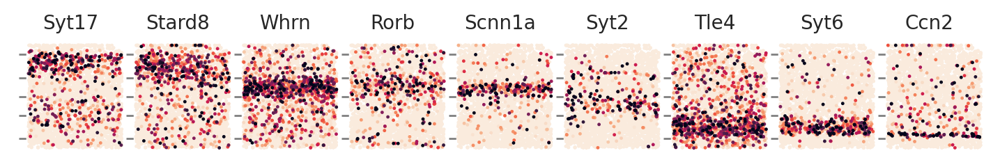

In [32]:
gns = [ 
    'Syt17', 'Stard8', 'Whrn', 'Rorb', 'Scnn1a', 'Syt2', 'Tle4', 'Syt6', 'Ccn2', 
] 
x =   adatasub.obs['width']
y =  -adatasub.obs['depth']
cutoff = np.logical_and(x>2000, x<3000)
n = len(gns)

fig, axs = plt.subplots(1,n,figsize=(n*1,3*1.2))
for i, (ax, gn) in enumerate(zip(axs, gns)):
    
    g = np.log2(1+adatasub[:,gn].layers['jnorm'].reshape(-1,))
    x = x[cutoff]
    y = y[cutoff]
    g = g[cutoff]
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  0)
    sorting = np.argsort(g)
    
    p = utils_merfish.st_scatter_ax(fig, ax,  x[sorting],  y[sorting],  gexp=g[sorting], 
                                    s=3, title='', vmin=vmin, vmax=vmax, cmap='rocket_r')
    ax.set_aspect('equal')
    
    ax.set_title(gn, fontsize=10) #, loc='left', va='center', ha='right', y=0.5, pad=None)
    # ax.hlines(-np.arange(0,1200,200), np.min(x)-100, np.min(x)-50, color='gray', linestyle='-', linewidth=1)
    ax.hlines(-np.array([100,350,550,750,1000]), np.min(x)-100, np.min(x), color='gray', linestyle='--', linewidth=1)
    
fig.subplots_adjust(hspace=0, wspace=-0.05)
plt.show()

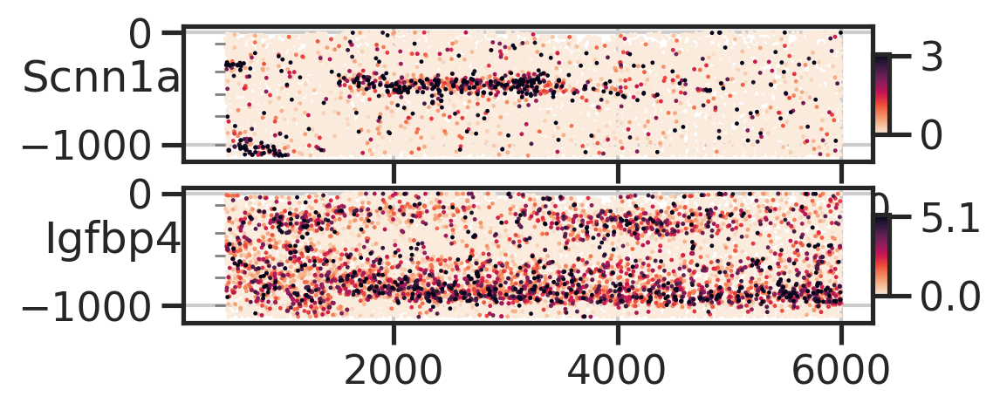

In [33]:
gns = [ 
    'Scnn1a', 'Igfbp4', #'Syt17', 'Rorb', #'Chrm2', 'Epha6',  
] 
x =   adatasub.obs['width']
y =  -adatasub.obs['depth']
n = len(gns)

fig, axs = plt.subplots(n,1,figsize=(1*6,n*1.2))
for i, (ax, gn) in enumerate(zip(axs, gns)):
    
    g = np.log2(1+adatasub[:,gn].layers['jnorm'].reshape(-1,))
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  0)
    sorting = np.argsort(g)
    
    p = utils_merfish.st_scatter_ax(fig, ax,  x[sorting],  y[sorting],  gexp=g[sorting], s=3, title='', vmin=vmin, vmax=vmax, cmap='rocket_r')
    ax.set_aspect('equal')
    
    ax.set_title(gn, loc='left', va='center', ha='right', y=0.5, pad=None)
    fig.colorbar(p, pad=0, shrink=0.5, aspect=5, ticks=[np.round(vmin, decimals=1), np.round(vmax-0.1, decimals=1)])
    
   # ax.hlines(-np.arange(0,1200,200), np.min(x)-100, np.min(x), color='gray', linestyle='-', linewidth=1)
    ax.hlines(-np.array([100,350,550,750,1000]), np.min(x)-100, np.min(x), color='gray', linestyle='-', linewidth=1)
    ax.axis('on')
fig.subplots_adjust(hspace=0)
plt.show()

In [34]:
bins = np.arange(500,6000+1, 250)
midbins = bins[:-1]+250/2

df = adatasub.obs.copy()
df['g'] = np.log2(1+np.array(adatasub[:,'Scnn1a'].layers['jnorm'][...])) # .reshape(-1,)
df = df[((df['depth']>350)&(df['depth']<550))] # take L4

df2 = adatasub.obs.copy()
df2['g'] = np.log2(1+np.array(adatasub[:,'Igfbp4'].layers['jnorm'][...])) # .reshape(-1,)
df2 = df2[((df2['depth']>150)&(df2['depth']<350))] # take L234

In [35]:
df['width_bin'] = pd.cut(df['width'], bins)
dfmean = df[['width_bin', 'g']].groupby('width_bin').mean()

df2['width_bin'] = pd.cut(df2['width'], bins)
dfmean2 = df2[['width_bin', 'g']].groupby('width_bin').mean()

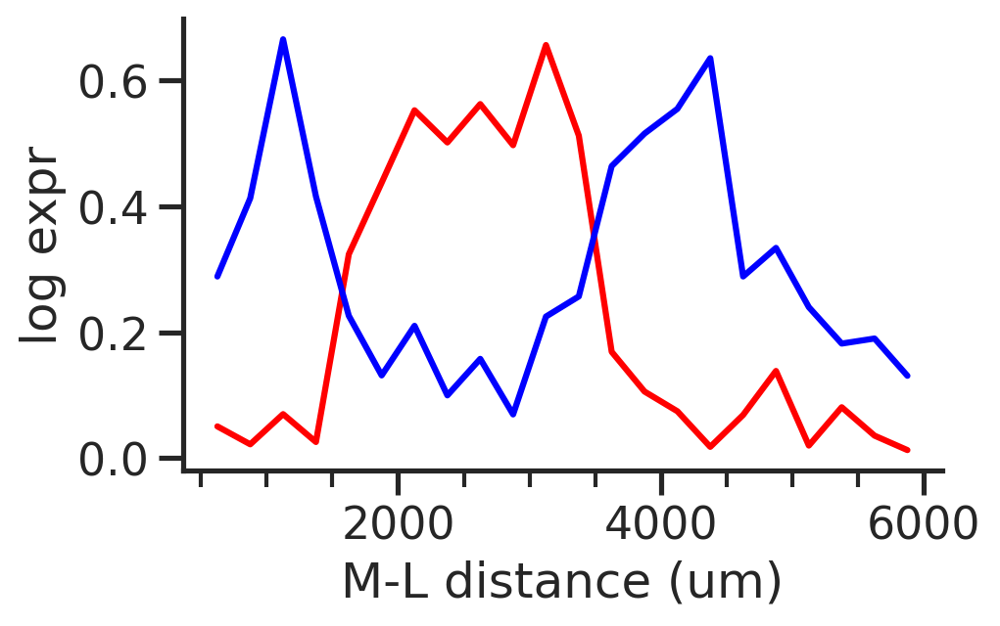

In [36]:
fig, ax = plt.subplots(figsize=(5,3))
ax.plot(midbins, dfmean['g'].values, color='red')
ax.plot(midbins, dfmean2['g'].values, color='blue')
ax.set_ylabel('log expr')
ax.set_xlabel('M-L distance (um)')
sns.despine(ax=ax)
ax.grid(False) # , axis='y')
ax.xaxis.set_ticks(np.arange(500,6000+1,500), minor=True)
plt.show()


# select V1 glut neurons

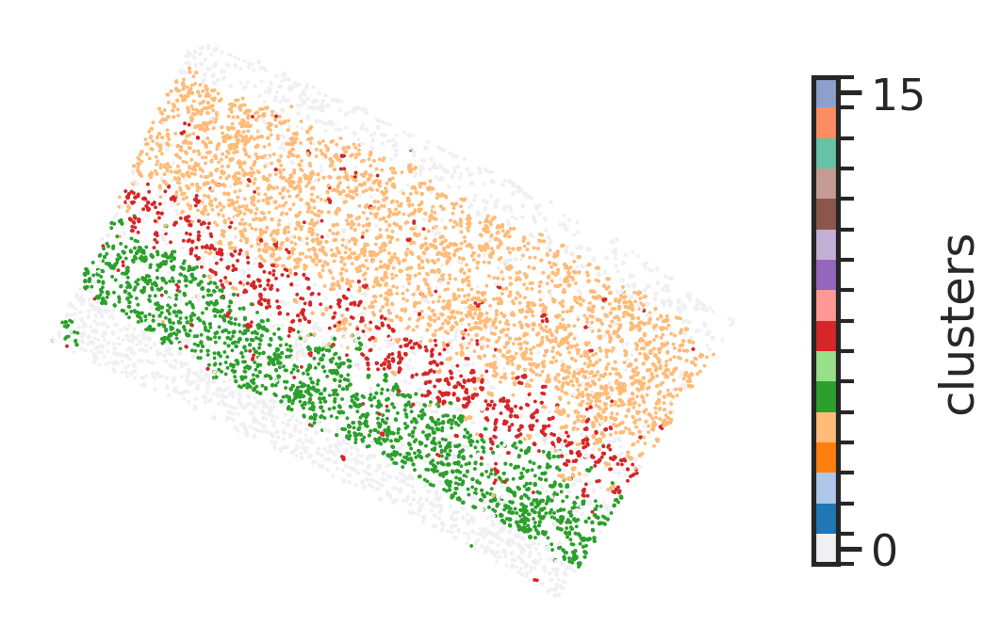

In [37]:
clsts_sel = [2,3,4,6,8,9]
clsts_sel = [3,4,6]
with sns.axes_style('white'): 
    fig, ax = plt.subplots()
    cond0 = np.logical_and(adatasub.obs['width']>1500, adatasub.obs['width']<3500)
    xr    = adatasub[cond0].obs['x']
    yr    = adatasub[cond0].obs['y']
    clsts = adatasub[cond0].obs['blended_domains'].astype(int) # requires [0,1,2...,N]
    clsts_this = clsts.copy()
    clsts_this[~clsts_this.isin(clsts_sel)] = -1
    clsts_this += 1
    
    utils_merfish.plot_cluster_simple_ax(fig, ax, clsts_this, xr, yr, s=2, cmap=clsts_cmap2) # cmap=plt.cm.tab20)
    plt.show()

In [38]:
cond1 = adatasub.obs['blended_domains'].astype(int).isin(clsts_sel)

<Axes: xlabel='transcript_count', ylabel='Count'>

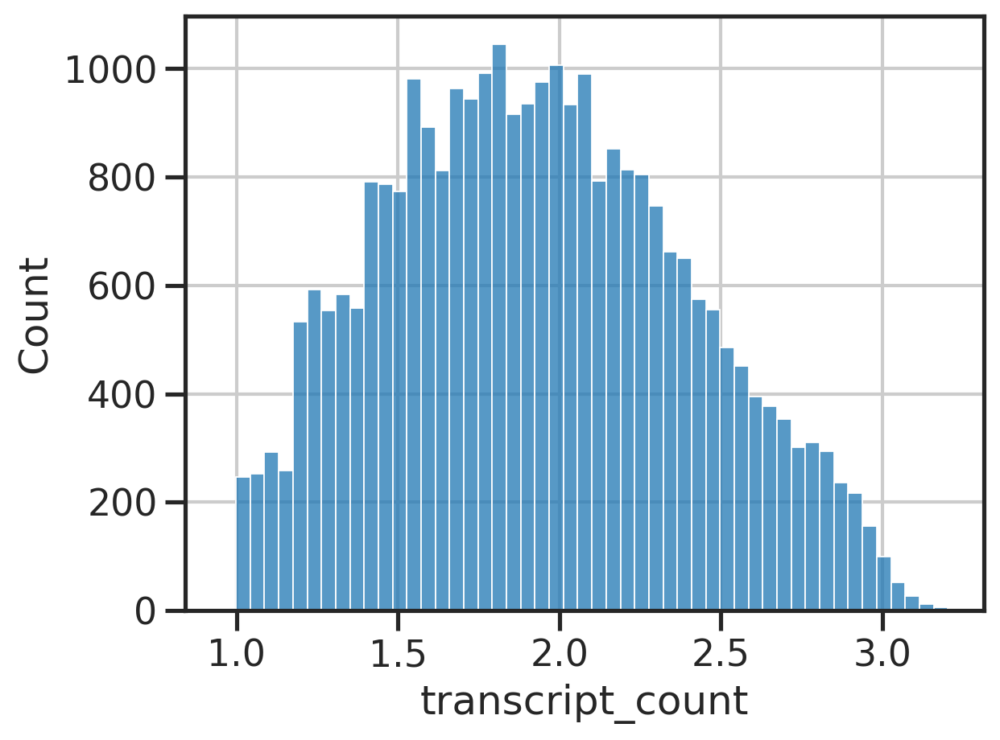

In [39]:
num_transcripts = adatasub.obs['transcript_count']
sns.histplot(np.log10(num_transcripts))

In [40]:
cond2 = num_transcripts > 50

In [41]:
adata_sel_raw = adatasub[cond0 & cond1 & cond2] # anatomical (V1 ctx), cell types, num transcripts
adata_sel_raw

View of AnnData object with n_obs × n_vars = 5775 × 500
    obs: 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'blended_domains', 'depth', 'width'
    uns: 'rotation', 'neighbors', 'xy', 'leiden', 'ref_line'
    obsm: 'blanks', 'X_pca', 'X_xy'
    layers: 'norm', 'jnorm'
    obsp: 'distances', 'connectivities', 'xy_distances', 'xy_connectivities'

In [42]:
# hvgs_merfish = get_hvgs(adata_sel, 'norm')
# adata_sel[:,hvgs_merfish]

# RNA data basic analysis 

In [43]:
def preprocessing(adata):
    # filter genes
    cond = np.ravel((adata.X>0).sum(axis=0)) > 10 # expressed in more than 10 cells
    adata_sub = adata[:,cond]

    # counts
    x = adata_sub.X
    cov = adata_sub.obs['n_counts'].values

    # CP10k
    xn = (sparse.diags(1/cov).dot(x))*1e4

    # log10(CP10k+1)
    xln = xn.copy()
    xln.data = np.log10(xln.data+1)

    adata_sub.layers['norm'] = xn
    adata_sub.layers['lognorm'] = xln
    
    return adata_sub

In [44]:
def get_hvgs(adata, layer, nbin=20, qth=0.3):
    """
    """
    xn = adata.layers[layer]
    
    # min
    gm = np.ravel(xn.mean(axis=0))

    # var
    tmp = xn.copy()
    tmp.data = np.power(tmp.data, 2)
    gv = np.ravel(tmp.mean(axis=0))-gm**2

    # cut 
    lbl = pd.qcut(gm, nbin, labels=np.arange(nbin))
    gres = pd.DataFrame()
    gres['lbl'] = lbl
    gres['mean'] = gm
    gres['var'] = gv
    gres['ratio']= gv/gm

    # select
    gres_sel = gres.groupby('lbl')['ratio'].nlargest(int(qth*(len(gm)/nbin))) #.reset_index()
    gsel_idx = np.sort(gres_sel.index.get_level_values(1).values)

    assert np.all(gsel_idx != -1)
    
    return adata.var.index.values[gsel_idx]

In [45]:
#
f = '/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/cheng21_cell_scrna/organized/P28NR.h5ad'
adata_rna_raw = sc.read(f)
adata_rna_raw

AnnData object with n_obs × n_vars = 23930 × 53801
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new', 'layer', 'Type', 'Subclass'

In [46]:
adata_rna_raw = adata_rna_raw[~adata_rna_raw.obs['subclass'].isnull()]
adata_rna_raw = preprocessing(adata_rna_raw)
adata_rna_raw

AnnData object with n_obs × n_vars = 15315 × 23128
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new', 'layer', 'Type', 'Subclass'
    layers: 'norm', 'lognorm'

In [47]:
hvgs = get_hvgs(adata_rna_raw, 'norm')
adata_rna = adata_rna_raw[:,hvgs]
adata_rna

View of AnnData object with n_obs × n_vars = 15315 × 6920
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new', 'layer', 'Type', 'Subclass'
    layers: 'norm', 'lognorm'

In [48]:
# genes overlap
genes_overlap = np.intersect1d(adata_rna.var.index.values, adata_sel_raw.var.index.values)
genes_overlap.shape

(409,)

In [49]:
adata_rna = adata_rna[:,genes_overlap]
adata_rna

View of AnnData object with n_obs × n_vars = 15315 × 409
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new', 'layer', 'Type', 'Subclass'
    layers: 'norm', 'lognorm'

In [50]:
zlognorm = stats.zscore(np.array(adata_rna.layers['lognorm'].todense()), axis=0)
pca = PCA(n_components=50, random_state=0)
pcs = pca.fit_transform(zlognorm)
adata_rna.obsm['X_pca'] = pcs

In [51]:
sc.pp.neighbors(adata_rna, use_rep='X_pca')
sc.tl.umap(adata_rna)

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


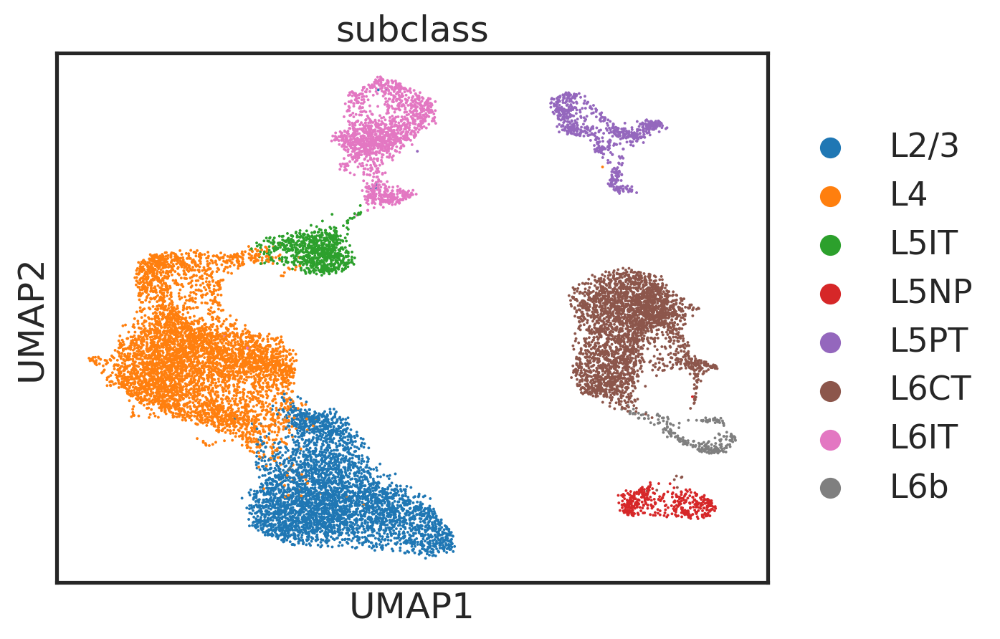

In [52]:
sc.pl.umap(adata_rna, color=["subclass"])

# integration - everything to everything - now good and takes too long

In [53]:
genes_overlap.shape, genes_overlap

((409,),
 array(['6530403H02Rik', 'Adamts17', 'Adamts2', 'Adra1a', 'Aifm3', 'Alcam',
        'Aldh1l1', 'Aldoc', 'Ankfn1', 'Apoe', 'Aqp4', 'Arc', 'Arhgef28',
        'Astn2', 'B3galt2', 'BC006965', 'Batf3', 'Baz1a', 'Bcl6', 'Bdnf',
        'Bmp6', 'Bmpr1a', 'Bmpr1b', 'Brinp3', 'C1ql3', 'C3ar1', 'Cacna1h',
        'Cacna2d3', 'Cacng8', 'Cadps2', 'Calb1', 'Camk2d', 'Camk4',
        'Car10', 'Cbln2', 'Cbr3', 'Ccbe1', 'Cd34', 'Cdh12', 'Cdh13',
        'Cdh18', 'Cdh20', 'Cdh4', 'Cdh6', 'Cdh8', 'Cdh9', 'Cebpb', 'Chl1',
        'Chrm2', 'Chrm3', 'Clmp', 'Cntn4', 'Cntn5', 'Cntn6', 'Cntnap2',
        'Cntnap5a', 'Cntnap5b', 'Coch', 'Col11a1', 'Col12a1', 'Col19a1',
        'Col23a1', 'Col25a1', 'Col26a1', 'Col27a1', 'Col6a1', 'Coro6',
        'Cplx3', 'Cpne4', 'Crem', 'Ctsb', 'Ctxn3', 'Cux1', 'Cux2', 'Dab1',
        'Dcbld2', 'Dcc', 'Ddit4l', 'Deptor', 'Dgkb', 'Dkk3', 'Dpyd',
        'Dscaml1', 'Eda', 'Efhd2', 'Efna5', 'Egfem1', 'Egr1', 'Egr2',
        'Egr4', 'Ell2', 'Endou', 'Enpp2', 'Epha10',

In [54]:
adata_rna = adata_rna[:,genes_overlap]
adata_mer = adata_sel_raw[:,genes_overlap]
adata_rna, adata_mer

(View of AnnData object with n_obs × n_vars = 15315 × 409
     obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new', 'layer', 'Type', 'Subclass'
     uns: 'neighbors', 'umap', 'subclass_colors'
     obsm: 'X_pca', 'X_umap'
     layers: 'norm', 'lognorm'
     obsp: 'distances', 'connectivities',
 View of AnnData object with n_obs × n_vars = 5775 × 409
     obs: 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'blended_domains', 'depth', 'width'
     uns: 'rotation', 'neighbors', 'xy', 'leiden', 'ref_line'
     obsm: 'blanks', 'X_pca', 'X_xy'
     layers: 'norm', 'jnorm'
     obsp: 'distances', 'connectivities', 'xy_distances', 'xy_connectivities')

In [55]:
adata_rna.obs['modality'] = 'rna'
adata_mer.obs['modality'] = 'merfish'
adata_merge = sc.concat([adata_rna, adata_mer], join='outer')
# adata_merge.obs.loc[adata_rna.obs.index, 'subclass'] = adata_rna.obs['subclass']
# adata_merge.obs.loc[adata_mer.obs.index, 'transcript_count'] = adata_mer.obs['transcript_count']

lognorm_rna = np.log10(1+np.array(adata_rna.layers['norm'].todense()))
zlognorm_rna = stats.zscore(lognorm_rna, axis=0)

lognorm_mer = np.log10(1+adata_mer.layers['norm'])
zlognorm_mer = stats.zscore(lognorm_mer, axis=0)

adata_merge.obsm['X_pca2'] = PCA(n_components=20).fit_transform(np.vstack([zlognorm_rna, zlognorm_mer])) 
adata_merge

/tmp/ipykernel_209908/3578502551.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_rna.obs['modality'] = 'rna'
/tmp/ipykernel_209908/3578502551.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_mer.obs['modality'] = 'merfish'


AnnData object with n_obs × n_vars = 21090 × 409
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new', 'layer', 'Type', 'Subclass', 'modality', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'blended_domains', 'depth', 'width'
    obsm: 'X_pca', 'X_umap', 'blanks', 'X_xy', 'X_pca2'
    layers: 'norm', 'lognorm', 'jnorm'

In [56]:
sc.external.pp.harmony_integrate(adata_merge, 'modality', basis='X_pca2', max_iter_harmony=20)

2024-07-18 13:43:20,402 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-07-18 13:43:23,470 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-07-18 13:43:23,561 - harmonypy - INFO - Iteration 1 of 20
2024-07-18 13:43:27,367 - harmonypy - INFO - Iteration 2 of 20
2024-07-18 13:43:31,163 - harmonypy - INFO - Converged after 2 iterations


In [57]:
sc.pp.neighbors(adata_merge, use_rep='X_pca_harmony')
sc.tl.umap(adata_merge) # , key='modality')
adata_merge.obs['umap1'] = adata_merge.obsm['X_umap'][:,0]
adata_merge.obs['umap2'] = adata_merge.obsm['X_umap'][:,1]

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


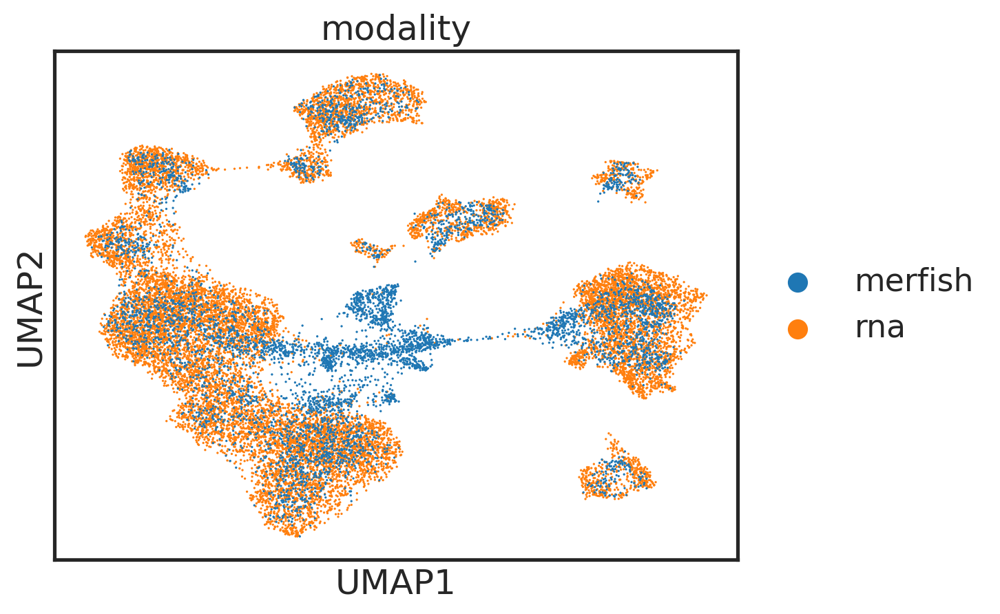

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


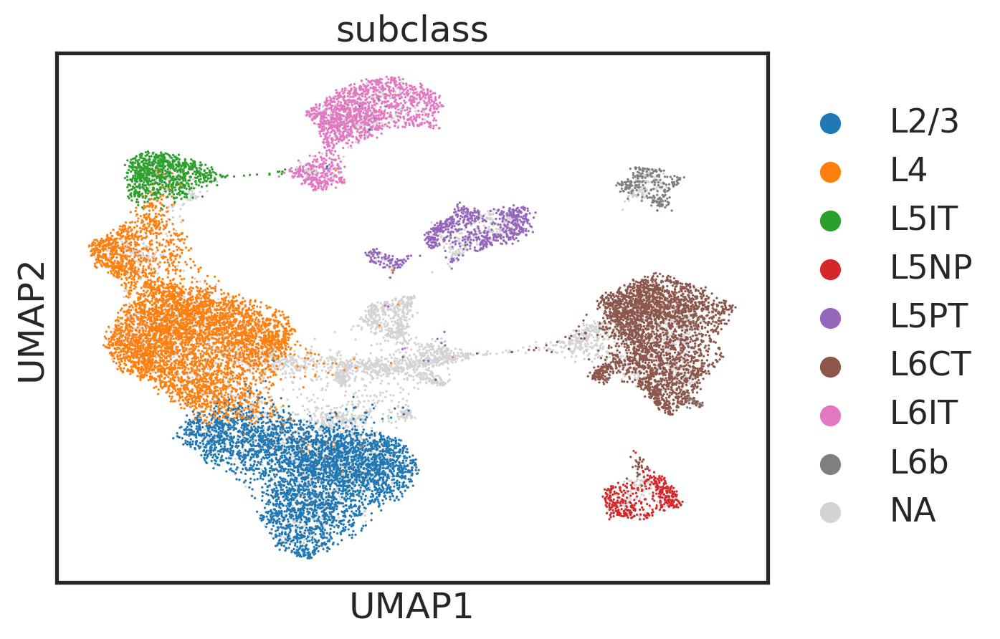

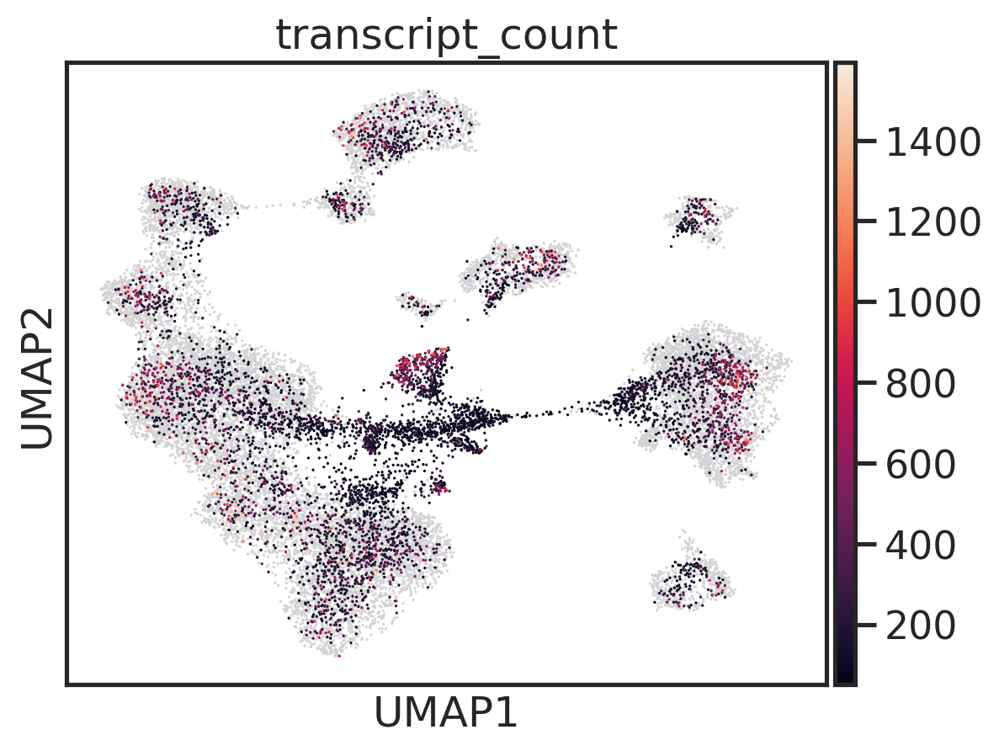

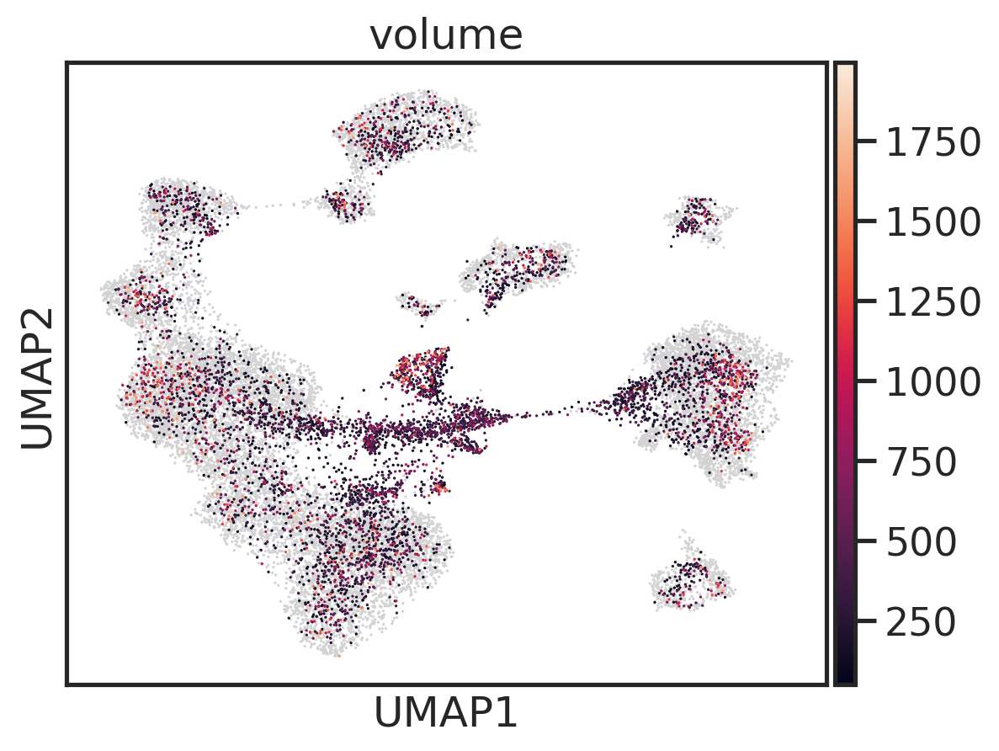

In [58]:
sc.pl.umap(adata_merge, color=["modality"])
sc.pl.umap(adata_merge, color=["subclass"])
sc.pl.umap(adata_merge, color=["transcript_count"])
sc.pl.umap(adata_merge, color=["volume"])

In [59]:
# label transfer from RNA data
from sklearn.neighbors import KNeighborsClassifier

ref = adata_merge[adata_rna.obs.index].copy()
qry = adata_merge[adata_mer.obs.index].copy()
knnc = KNeighborsClassifier(n_neighbors=30)

# report distance cutoff
knnc.fit(ref.obsm['X_pca_harmony'], ref.obs['subclass'].values)

qry.obs['pred'] = knnc.predict(qry.obsm['X_pca_harmony'])
ref.obs['pred'] = knnc.predict(ref.obsm['X_pca_harmony'])
adata_merge.obs['pred'] = knnc.predict(adata_merge.obsm['X_pca_harmony'])

In [60]:
from sklearn.neighbors import NearestNeighbors

def neighbor_label_transfer(k, ref_emb, qry_emb, ref_lbl, p_cutoff=0.5, dist_cutoff=None):
    """ref vs qry neighbors
    """
    unq_lbls = np.unique(ref_lbl).astype(str) # array(['L2/3_A', 'L2/3_B', 'L2/3_C'])
    n_unq_lbls = len(unq_lbls)
    ref_n = len(ref_emb)
    qry_n = len(qry_emb)
    
    neigh = NearestNeighbors(n_neighbors=k) # , radius=0.4)
    neigh.fit(ref_emb)
    dists, idx = neigh.kneighbors(qry_emb, k, return_distance=True)
    
    raw_pred = ref_lbl[idx]

    # p
    pabc = np.empty((qry_n, n_unq_lbls))
    for i, lbl in enumerate(unq_lbls):
        p = np.sum(raw_pred==lbl, axis=1)/k
        pabc[:,i] = p

    # max
    max_pred = unq_lbls[np.argmax(pabc, axis=1)]

    # 
    gated_pred = max_pred.copy()
    cond1 = np.max( pabc, axis=1) > p_cutoff
    gated_pred[~cond1] = 'NA' 
    if dist_cutoff is not None:
        cond2 = np.max(dists, axis=1) < dist_cutoff
        gated_pred[~cond2] = 'NA' 
    
    return max_pred, gated_pred, np.max(dists, axis=1)


def neighbor_self_nonself(k, ref_emb, qry_emb):
    """ref vs qry neighbors
    """
    unq_lbls = np.unique(ref_lbl).astype(str) # array(['L2/3_A', 'L2/3_B', 'L2/3_C'])
    n_unq_lbls = len(unq_lbls)
    ref_n = len(ref_emb)
    qry_n = len(qry_emb)
    lbls = np.array([0]*ref_n+[1]*qry_n)
    
    neigh = NearestNeighbors(n_neighbors=k) # , radius=0.4)
    neigh.fit(np.vstack([ref_emb, qry_emb]))
    idx = neigh.kneighbors(qry_emb, k, return_distance=False)
    
    isself = lbls[idx]

    p = np.sum(isself, axis=1)/k

    
    return p # max_pred, gated_pred, np.max(dists, axis=1)

In [61]:
ref_emb = ref.obsm['X_pca_harmony']
qry_emb = qry.obsm['X_pca_harmony']
ref_lbl = ref.obs['subclass'].values.astype(str) # res_nr['type'].values.astype(str)
print(np.unique(ref_lbl))

k = 100
max_pred, _, dists = neighbor_label_transfer(k, ref_emb, qry_emb, ref_lbl, p_cutoff=0.5, dist_cutoff=None)
ps = neighbor_self_nonself(k, ref_emb, qry_emb)

adata_merge.obs['max_pred'] = 'NA' 
adata_merge.obs['frac_self_neighbors'] = np.nan # 'NA'
adata_merge.obs['gated_pred'] = 'NA'

adata_merge.obs.loc[qry.obs.index, 'max_pred'] = max_pred
adata_merge.obs.loc[qry.obs.index, 'frac_self_neighbors'] = ps
adata_merge.obs.loc[qry.obs.index, 'gated_pred'] = np.where(ps < 0.98, max_pred, 'NA')

['L2/3' 'L4' 'L5IT' 'L5NP' 'L5PT' 'L6CT' 'L6IT' 'L6b']


In [62]:
adata_snrnasq = adata_merge[adata_rna.obs.index] #adata_merge.obs['modality']=='merfish']
adata_merfish = adata_merge[adata_mer.obs.index] #adata_merge.obs['modality']=='merfish']
adata_snrnasq, adata_merfish

(View of AnnData object with n_obs × n_vars = 15315 × 409
     obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'sample', 'Age', 'subclass', 'sample_new', 'layer', 'Type', 'Subclass', 'modality', 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DAPI_raw', 'DAPI_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'blended_domains', 'depth', 'width', 'umap1', 'umap2', 'pred', 'max_pred', 'frac_self_neighbors', 'gated_pred'
     uns: 'neighbors', 'umap', 'modality_colors', 'subclass_colors'
     obsm: 'X_pca', 'X_umap', 'blanks', 'X_xy', 'X_pca2', 'X_pca_harmony'
     layers: 'norm', 'lognorm', 'jnorm'
     obsp: 'distances', 'connectivities',
 View of AnnData object with n_obs × n_vars = 5775 × 409
     obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Double

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


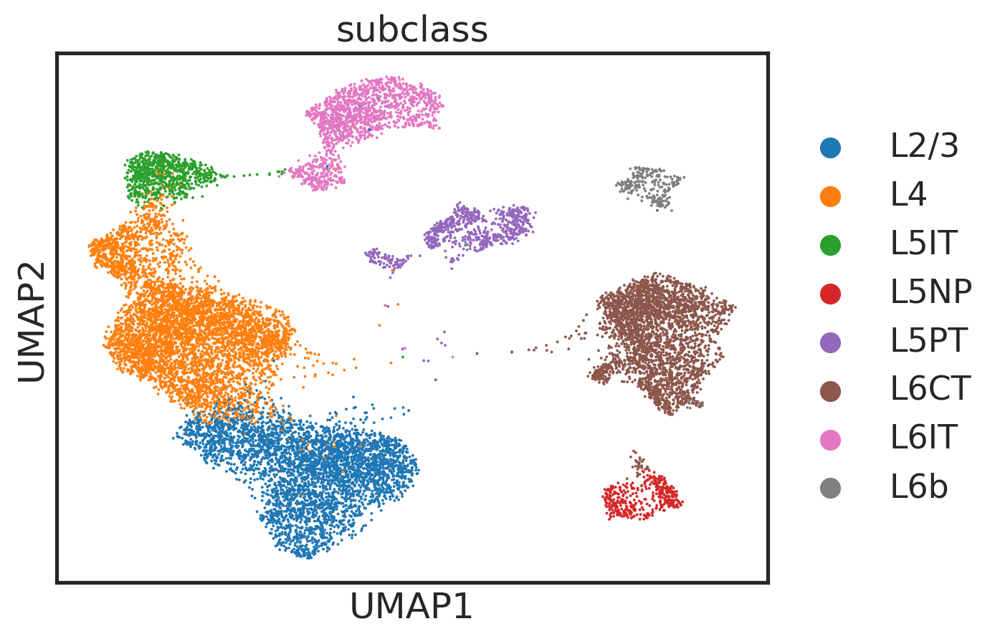

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


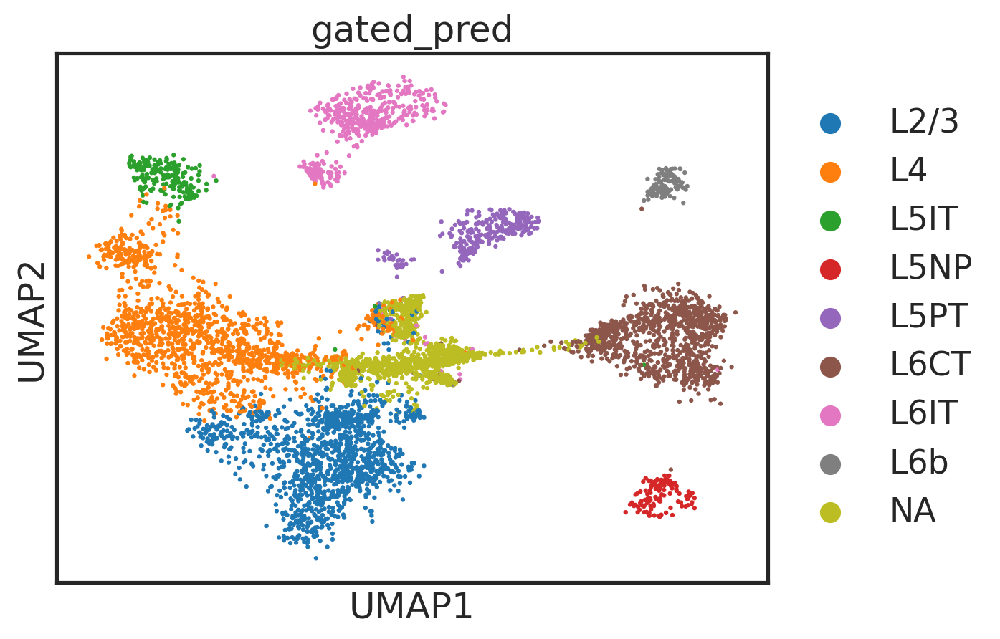

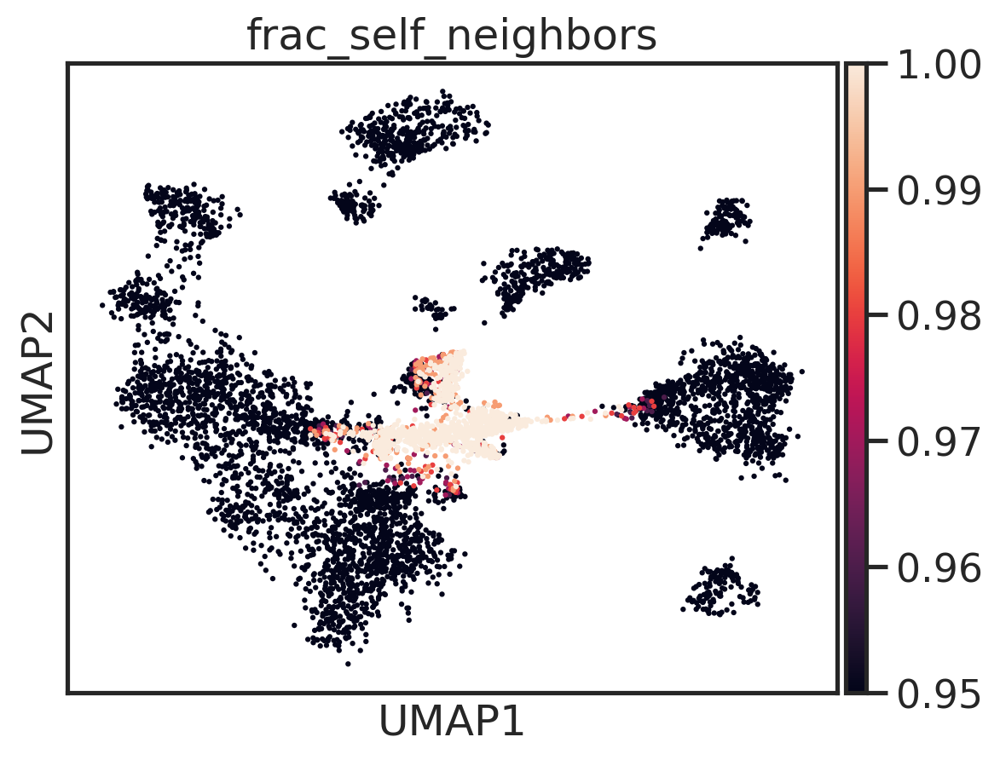

In [63]:
sc.pl.umap(adata_snrnasq, color=['subclass'])
sc.pl.umap(adata_merfish, color=['gated_pred'])
sc.pl.umap(adata_merfish, color=['frac_self_neighbors'], vmin=0.95)

In [64]:
sns.color_palette('tab20')

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (1.0, 0.7333333333333333, 0.47058823529411764),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (1.0, 0.596078431372549, 0.5882352941176471),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.7725490196078432, 0.6901960784313725, 0.8352941176470589),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.7686274509803922, 0.611764705882353, 0.5803921568627451),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.9686274509803922, 0.7137254901960784, 0.8235294117647058),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7803921568627451, 0.7803921568627451, 0.7803921568627451),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.8588235294117647, 0.8588235294117647, 0.5529411764705883),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
 (0.6196078431372549, 0.8549019607843137, 0.8980392156862745)]

In [65]:
x =   adata_merfish.obs['width']
y =  -adata_merfish.obs['depth']
ux =  adata_merfish.obsm['X_umap'][:,0]
uy =  adata_merfish.obsm['X_umap'][:,1]
clsts_lbl = adata_merfish.obs['gated_pred'].values
clsts, _ = pd.factorize(clsts_lbl) # .astype(int) # requires [0,1,2...,N]
clsts_palette, clsts_cmap = generate_discrete_cmap([len(np.unique(clsts))], keys=['Set2',])

csel = 'tab20'
clsts_palette2 = {
    'L2/3': sns.color_palette(csel, 8)[0], # 'C0', 
    'L4'  : sns.color_palette(csel, 8)[1], 
    'L5IT': sns.color_palette(csel, 8)[2], 
    'L5NP': sns.color_palette(csel, 8)[3], 
    'L5PT': sns.color_palette(csel, 8)[4], 
    'L6IT': sns.color_palette(csel, 8)[5], 
    'L6CT': sns.color_palette(csel, 8)[6], 
    'L6b' : sns.color_palette(csel, 8)[7],
    'NA': 'gray',
}
np.sort(_)

array(['L2/3', 'L4', 'L5IT', 'L5NP', 'L5PT', 'L6CT', 'L6IT', 'L6b', 'NA'],
      dtype=object)

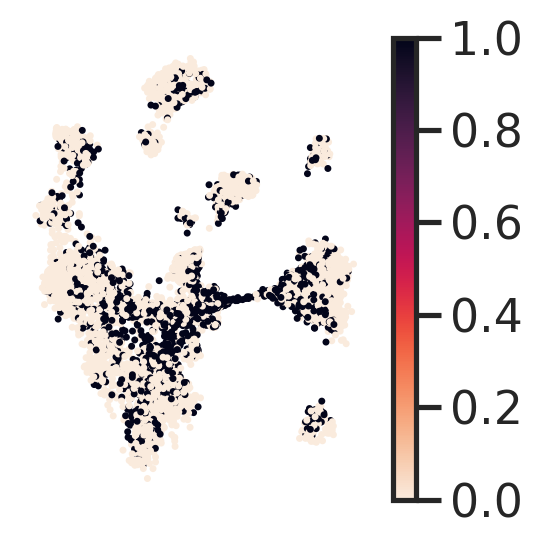

In [66]:
fig, ax = plt.subplots(1,1,figsize=(1*3,1*3))
# c = np.log10(adata_merfish.obs['transcript_count'].values)
c = adata_merfish.obs['transcript_count'].values

sorting = np.argsort(c) # [::-1]
# g = ax.scatter(ux[sorting], uy[sorting], c=c[sorting], s=1, cmap='rocket_r') 
g = ax.scatter(ux, uy, c=c<100, s=1, cmap='rocket_r') 
ax.set_aspect('equal')
ax.axis('off')
fig.colorbar(g)
plt.show()



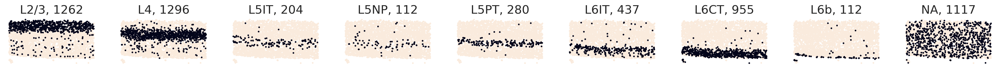

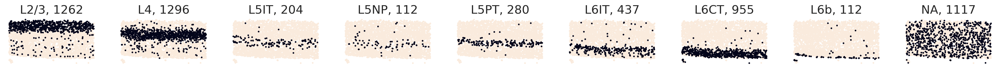

In [68]:
n = len(clsts_palette2.keys())
fig, axs = plt.subplots(1,n,figsize=(n*3,1*3))
for i, key in enumerate(clsts_palette2.keys()):
    ax = axs[i]
    c = (clsts_lbl==key).astype(int)
    sorting = np.argsort(c) # [::-1]
    num = c.sum()
    ax.scatter(x[sorting], y[sorting], c=c[sorting], s=1, cmap='rocket_r') 
    # ax.scatter(x, y, c=c, s=1, cmap='rocket_r') 
    ax.set_aspect('equal')
    ax.axis('off')
    ax.set_title(f'{key}, {num}')
plt.show()

n = len(clsts_palette2.keys())
fig, axs = plt.subplots(1,n,figsize=(n*3,1*3))
for i, key in enumerate(clsts_palette2.keys()):
    ax = axs[i]
    c = (clsts_lbl==key).astype(int)
    sorting = np.argsort(c) # [::-1]
    num = c.sum()
    ax.scatter(x[sorting], y[sorting], c=c[sorting], s=1, cmap='rocket_r') 
    # ax.scatter(x, y, c=c, s=1, cmap='rocket_r') 
    ax.set_aspect('equal')
    ax.axis('off')
    ax.set_title(f'{key}, {num}')
plt.show()

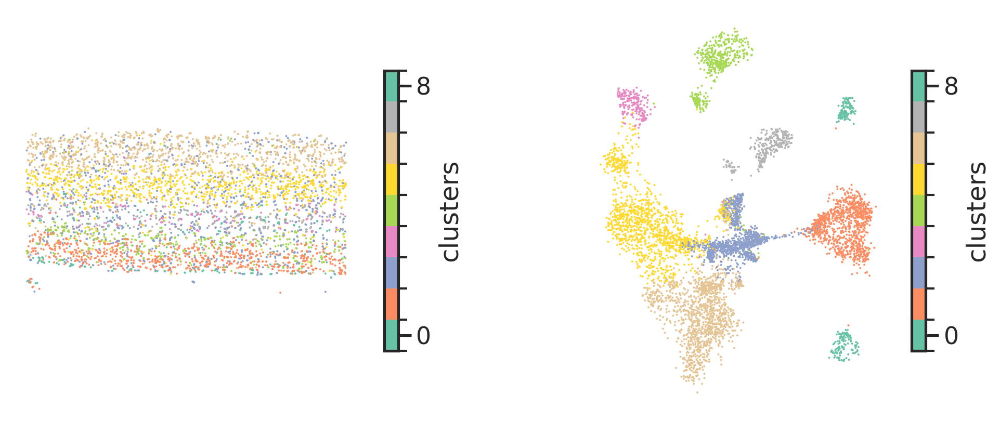

In [69]:

with sns.axes_style('white'): 
    fig, axs = plt.subplots(1,2,figsize=(2*6,1*5))
    ax = axs[0]
    utils_merfish.plot_cluster_simple_ax(fig, ax, clsts, x, y, s=2, cmap=clsts_cmap) # cmap=plt.cm.tab20)
    
    ax = axs[1]
    utils_merfish.plot_cluster_simple_ax(fig, ax, clsts, ux, uy, s=2, cmap=clsts_cmap) # cmap=plt.cm.tab20)
    plt.show()

saved the figure to: /u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/plots_240718/fig1_dw_2024-07-18.pdf


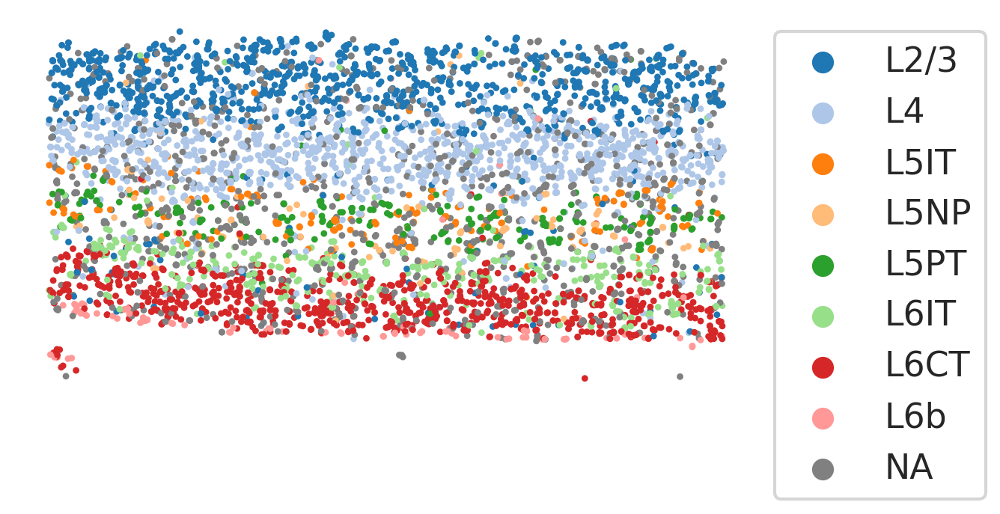

In [70]:
fig, ax = plt.subplots()
sns.scatterplot(data=adata_merfish.obs.sample(frac=1, replace=False), 
                x='width', y='depth', 
                # x='x', y='y', 
                hue='gated_pred', palette=clsts_palette2, hue_order=list(clsts_palette2.keys()),
                s=10, edgecolor='none', ax=ax, rasterized=True)
ax.legend(bbox_to_anchor=(1,1))
ax.axis('off')
ax.set_aspect('equal')
ax.invert_yaxis()
powerplots.savefig_autodate(fig, os.path.join(outdir, 'fig1_dw.pdf'))
plt.show()

saved the figure to: /u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/plots_240718/fig1_umap_2024-07-18.pdf


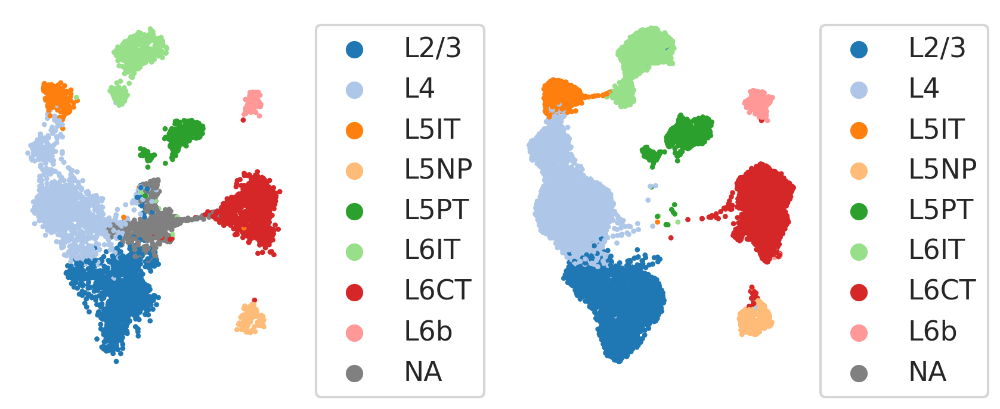

In [71]:
fig, axs = plt.subplots(1,2,figsize=(5*2,4), sharex=True, sharey=True)
for ax, adata_mod, col in zip(axs, [adata_merfish, adata_snrnasq], ['gated_pred', 'subclass']):
    sns.scatterplot(data=adata_mod.obs.sample(frac=1, replace=False), 
                    x='umap1', y='umap2', 
                    hue=col, palette=clsts_palette2, hue_order=list(clsts_palette2.keys()),
                    s=10, edgecolor='none', ax=ax, rasterized=True)
    ax.legend(bbox_to_anchor=(1,1))
    ax.axis('off')
    ax.set_aspect('equal')
powerplots.savefig_autodate(fig, os.path.join(outdir, 'fig1_umap.pdf'))
plt.show()

In [72]:
m =  adata_merge[adata_rna.obs.index].obs['subclass'].value_counts() # /len(adata_rna)
m = m/m.sum()
n =  adata_merge[adata_mer.obs.index].obs['gated_pred'].value_counts() # /len(adata_mer)).loc[m.index]
print(n.loc['NA']/n.sum())
n = n.loc[m.index]
n = n/n.sum()
# n = (n/n.sum()).loc[m.index]

m, n


0.1934199134199134


(L4      0.325106
 L2/3    0.252759
 L6CT    0.190336
 L6IT    0.092915
 L5IT    0.051453
 L5PT    0.046229
 L5NP    0.025531
 L6b     0.015671
 Name: subclass, dtype: float64,
 L4      0.278231
 L2/3    0.270932
 L6CT    0.205024
 L6IT    0.093817
 L5IT    0.043796
 L5PT    0.060112
 L5NP    0.024045
 L6b     0.024045
 Name: gated_pred, dtype: float64)

saved the figure to: /u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/plots_240718/fig1_scatter_2024-07-18.pdf


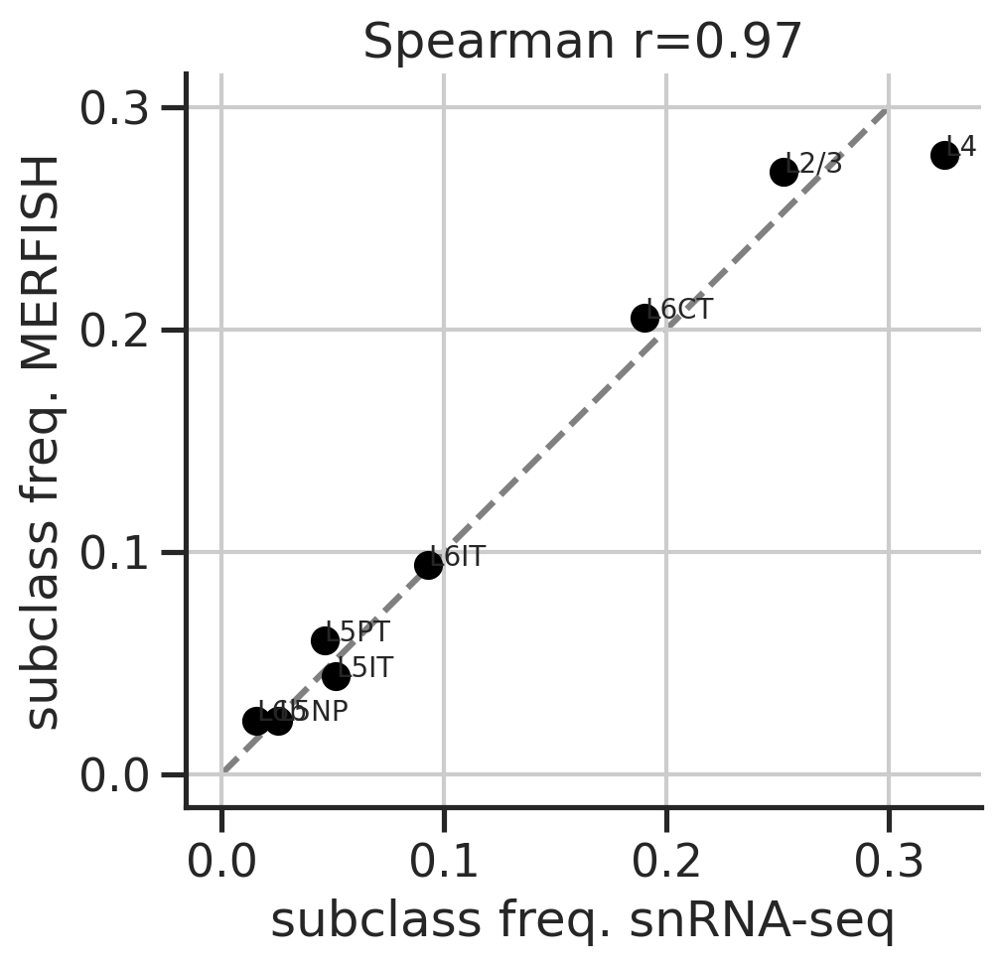

In [73]:
fig, ax = plt.subplots()
ax.scatter(m, n, color='k')
r, p = stats.spearmanr(m.values, n.values)
for i in range(len(m)):
    ax.text(m.iloc[i], n.iloc[i], m.index.values[i], fontsize=10)
    
ax.set_title(f"Spearman r={r:.2g}")

ax.plot([0, 0.3], [0, 0.3], '--', color='gray', zorder=0)
ax.set_aspect('equal')
ax.set_xticks([0,0.1,0.2,0.3])
ax.set_yticks([0,0.1,0.2,0.3])
sns.despine(ax=ax)

ax.set_xlabel('subclass freq. snRNA-seq')
ax.set_ylabel('subclass freq. MERFISH')
powerplots.savefig_autodate(fig, os.path.join(outdir, 'fig1_scatter.pdf'))
                            
plt.show()

# astrocytes genes

In [48]:
astro_genes = np.sort([
    "Nr1d1",
    "Junb",
    "Mertk",
    "Slc1a3",
    "Nrxn1",
    "Sox21",
    "Fosl2",
    "Id3",
    "Stat2",
    "Klf3",
    "Rora",
    "Sdc4",
])
astro_genes

array(['Fosl2', 'Id3', 'Junb', 'Klf3', 'Mertk', 'Nr1d1', 'Nrxn1', 'Rora',
       'Sdc4', 'Slc1a3', 'Sox21', 'Stat2'], dtype='<U6')

In [49]:
astro_genes_overlap = np.intersect1d(astro_genes, genes)
astro_genes_overlap

array(['Fosl2', 'Id3', 'Junb', 'Klf3', 'Mertk', 'Nr1d1', 'Nrxn1', 'Rora',
       'Sdc4', 'Slc1a3', 'Sox21', 'Stat2'], dtype=object)

# Redo QC, add norm, PCA

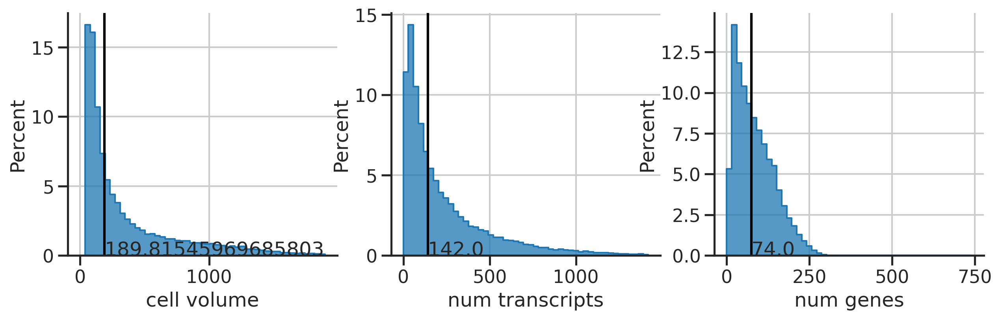

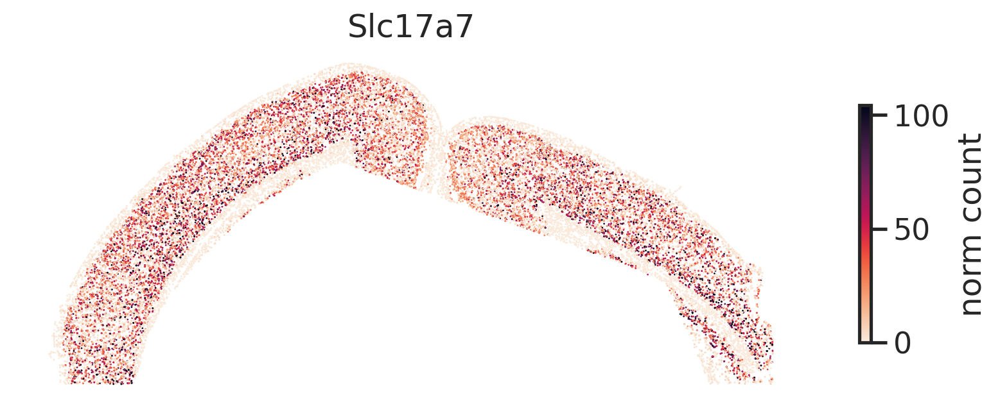

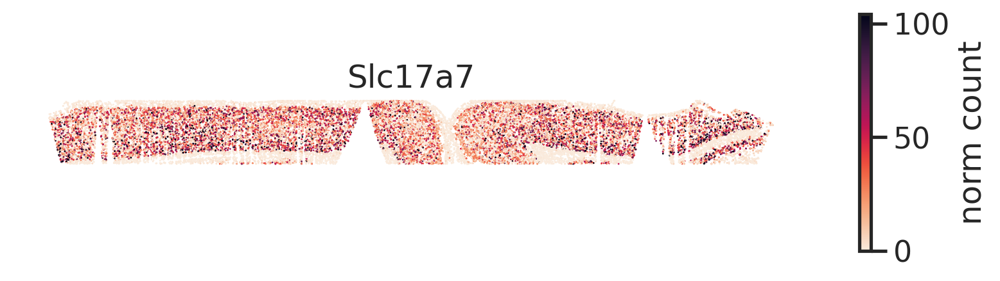

In [19]:
# redo metrics
metrics = get_qc_metrics(adatasub2.obs)
# norm
nrmcnts = get_norm_counts(adatasub2)
# pca
adatasub2.obsm['pca'] = PCA(n_components=10).fit_transform(adatasub2.layers['norm'])


# check QCs
fig, axs = plt.subplots(1,3,figsize=(3*5,1*4))
for ax, (key, metric) in zip(axs, metrics.items()):
    (name, val, medval, bins) = metric
    
    sns.histplot(val, element='step', bins=bins, ax=ax, stat='percent')
    sns.despine(ax=ax)
    ax.axvline(medval, color='k',)
    ax.text(medval, 0, medval)
    ax.set_xlabel(name)
plt.show()

# check
gn = 'Slc17a7'
xr = adatasub2.obs['x']
yr = adatasub2.obs['y']
g = adatasub2[:,gn].layers['norm']
st_scatter(xr, yr, gexp=g, title=gn, cbar_label='norm count', axis_off=True)
plt.show()

# check
gn = 'Slc17a7'
d = adatasub2.obs['depth']
w = adatasub2.obs['width']
g = adatasub2[:,gn].layers['norm']
st_scatter(w, -d, gexp=g, title=gn, cbar_label='norm count', axis_off=True)
plt.show()

# Annotate V1 boundaries
- and add that to meta_operations

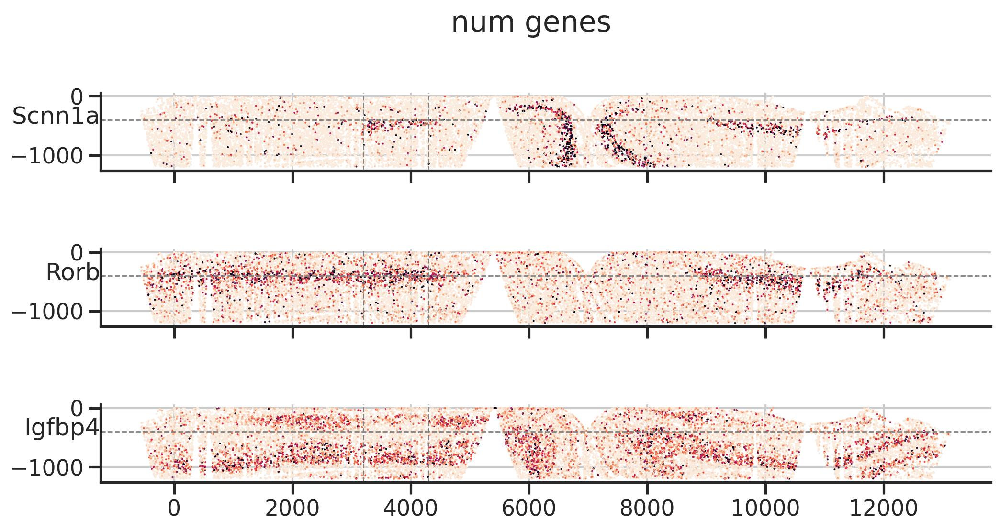

In [24]:

bound_l, bound_r, bound_d = 3200, 4300, 400
cond = np.all([
    adatasub2.obs['width'] > bound_l, 
    adatasub2.obs['width'] < bound_r, 
    adatasub2.obs['depth'] < bound_d, 
], axis=0)
adatasub2.obs['inside_v1l23'] = cond
meta_operations['bound_lrd'] = [bound_l, bound_r, bound_d]

gns = ['Scnn1a', 'Rorb', 'Igfbp4', ]
n = len(gns)
x =  adatasub2.obs['width']
y = -adatasub2.obs['depth']

fig, axs = plt.subplots(n,1,figsize=(1*12,n*2), sharex=True, sharey=True)
fig.suptitle(name)
for ax, gn in zip(axs, gns):
    g = adatasub2[:,gn].layers['norm'].reshape(-1,)
    
    vmax = np.percentile(g, 99)
    vmin = np.percentile(g,  5)
    cond = g > 1e-5
    
    utils_merfish.st_scatter_ax(fig, ax, x[~cond], y[~cond], gexp=g[~cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    utils_merfish.st_scatter_ax(fig, ax,  x[cond],  y[cond],  gexp=g[cond], s=2, title='', vmin=vmin, vmax=vmax, cmap='rocket_r') #, axis_off=False)
    
    ax.set_title(gn, loc='left', ha='right', y=0.5)
    ax.axhline(-bound_d, linestyle='--', linewidth=1, color='gray', zorder=2)
    ax.axvline( bound_l, linestyle='--', linewidth=1, color='gray', zorder=2)
    ax.axvline( bound_r, linestyle='--', linewidth=1, color='gray', zorder=2)
    ax.grid(True)
    ax.axis('on')
    sns.despine(ax=ax)
    
plt.show()

In [25]:
adatasub2.uns = meta_operations
adatasub2

AnnData object with n_obs × n_vars = 40280 × 500
    obs: 'EntityID', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'min_y', 'max_x', 'max_y', 'anisotropy', 'transcript_count', 'perimeter_area_ratio', 'solidity', 'DreO_raw', 'DreO_high_pass', 'Cre_raw', 'Cre_high_pass', 'DAPI_raw', 'DAPI_high_pass', 'FlpO_raw', 'FlpO_high_pass', 'Pvalb_raw', 'Pvalb_high_pass', 'Sst_raw', 'Sst_high_pass', 'Fth1_raw', 'Fth1_high_pass', 'PolyT_raw', 'PolyT_high_pass', 'gncov', 'gnnum', 'fpcov', 'x', 'y', 'depth', 'width', 'inside_v1l23'
    uns: 'rotation', 'ref_line', 'bound_lrd'
    obsm: 'blanks', 'pca'
    layers: 'norm'

In [1]:
print(output)

NameError: name 'output' is not defined

In [27]:
adatasub2.write(output)

In [29]:
!ls /u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/merfish/organized/*240506.h5ad

/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/data/merfish/organized/P28NRb_ant_ctxglut_240506.h5ad
